## Code Attribution

The code presented in this section, which generates dynamic spectra with varying pulse parameters, is the result of my work and has been adapted from Python notebooks authored by Joseph Kania. These notebooks utilized the WILL (Weighted Injector of Luminous Lighthouses) Python package.

### Code Author
- **Dirk Kuiper**

### Sources
The code has been adjusted and customized from the following sources:

- Joseph Kania's Python example notebooks, which provided the foundational code for generating dynamic spectra with pulses. These notebooks served as a valuable reference and inspiration for the implementation of the following code.

- The WILL (Weighted Injector of Luminous Lighthouses) Python package, which was used for several functions and utilities, enhancing the capabilities of the code.


## Show how we can inject a pulse into a GREENBURST filterbank.

In [1]:
import matplotlib.pyplot as plt
import numpy as np
from jess.dispersion import dedisperse
from jess.fitters import median_fitter
from scipy.stats import median_abs_deviation
from will import create, inject, detect
from simulate_frbs import *
from plotting import *

## Creating a fresh filterbank file from scratch

Code adapted from: https://thepetabyteproject.github.io/your/0.6.6/ipynb/Writer/

I tried to make the header as consistent as possible with the Greenbank data from Zenodo, in case we will want to use it later to test with RFI etc.

In [2]:
# Create a filterbank with noise, std is such that the lightcurve will have std 1
create_filterbank_with_noise("output_with_noise__2.fil", std_value=np.sqrt(1.0/512), mean_value=0.0, num_frequency_channels=1000, num_time_samples=1024)

(1024, 1000)


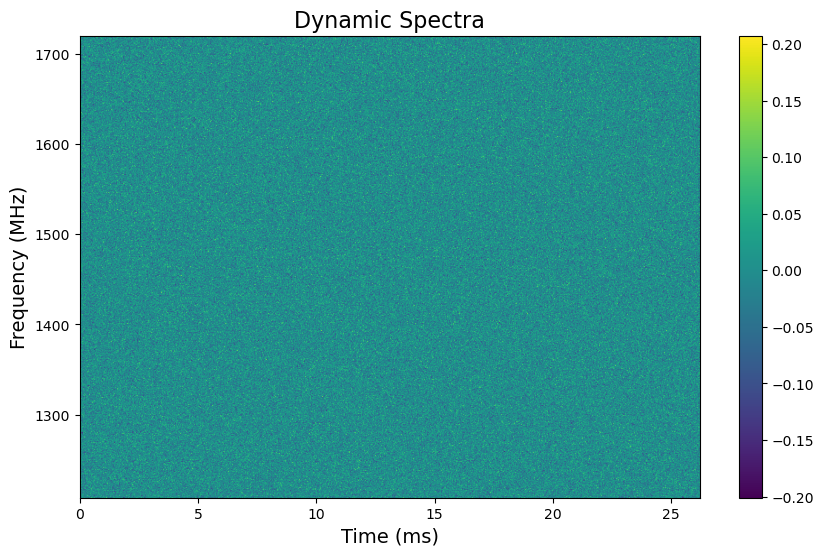

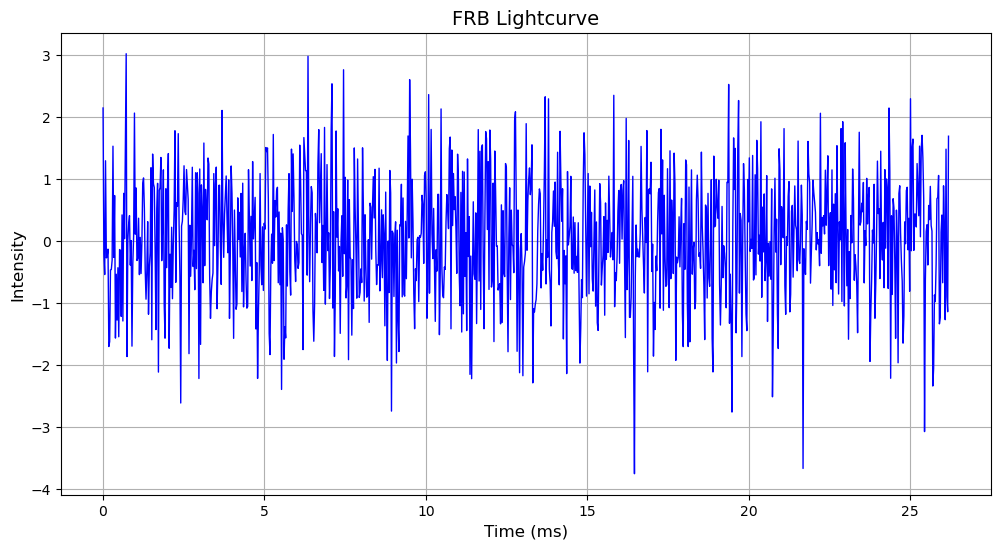

In [11]:
# Get the dynamic spectra from a filterbank file with 1024 time samples
dynamic_spectra, yr_obj = get_dynamic_spectra_from_filterbank(file_name='output_with_noise__2.fil', num_time_samples=1024)
print(dynamic_spectra.shape)

# Crop the dynamic spectra
dynamic_spectra = dynamic_spectra[:, 208:720]


# Plot the dynamic spectra
plot_dynamic_spectra(dynamic_spectra)

# Sum the dynamic spectra along the frequency axis to create a lightcurve
lightcurve = np.sum(dynamic_spectra, axis=1)

# Plot the lightcurve using time sample numbers as the x-axis
plot_lightcurve(lightcurve=lightcurve, time_samples=np.arange(1024))


## Create a simple Pulse

In [105]:
def generate_center_freq(min_freq, max_freq):
    """
    Generate a random frequency center within the specified range.

    Parameters:
        min_freq (float): Minimum frequency in MHz.
        max_freq (float): Maximum frequency in MHz.

    Returns:
        float: Random center frequency within the specified range.
    """
    center_freq = np.random.uniform(min_freq, max_freq)
    return center_freq

def generate_sigma_freq(min_sigma, max_sigma):
    """
    Generate a random frequency width (sigma_freq) within the specified range.

    Parameters:
        min_sigma (float): Minimum frequency width (sigma_freq).
        max_sigma (float): Maximum frequency width (sigma_freq).

    Returns:
        float: Random sigma_freq within the specified range.
    """
    sigma_freq = np.random.uniform(min_sigma, max_sigma)
    return sigma_freq

def generate_sigma_time(mean, std):
    """
    Generate a random time width (sigma_time) from a normal distribution within the specified range.

    Parameters:
        mean (float): Mean value of the normal distribution.
        std (float): Standard deviation of the normal distribution.

    Returns:
        float: Random sigma_time within the specified range.
    """
    sigma_time = np.random.normal(loc=mean, scale=std)
    return sigma_time



(304, 512)


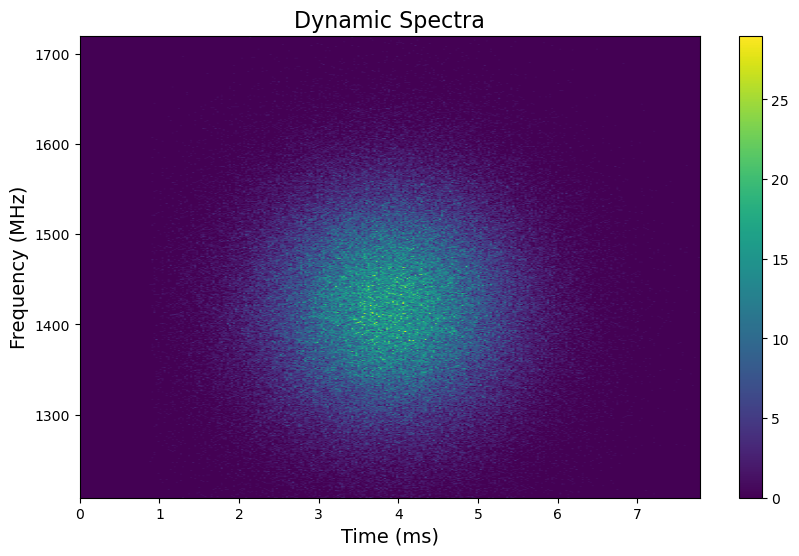

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0009845512748630574
Frequency: 81.74780148039137
Center Frequency: 1419.5091227644878
(184, 512)


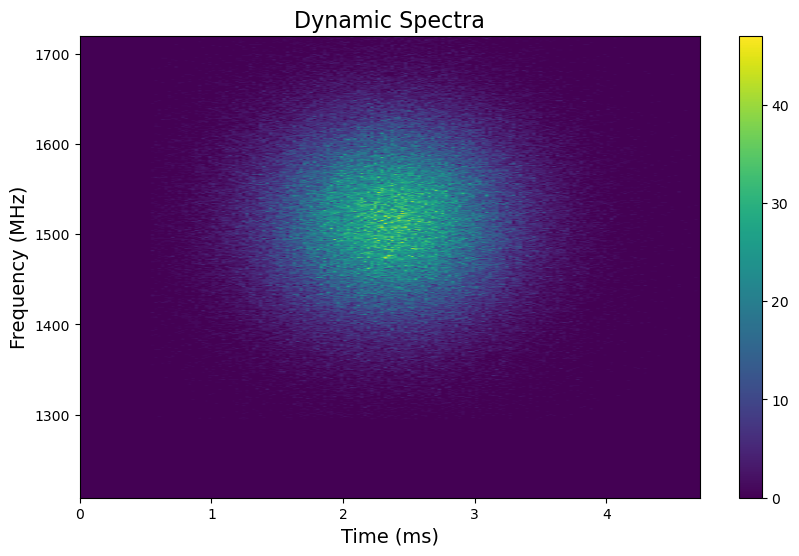

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0005901059162600013
Frequency: 71.20284655775919
Center Frequency: 1515.6789895136171
(120, 512)


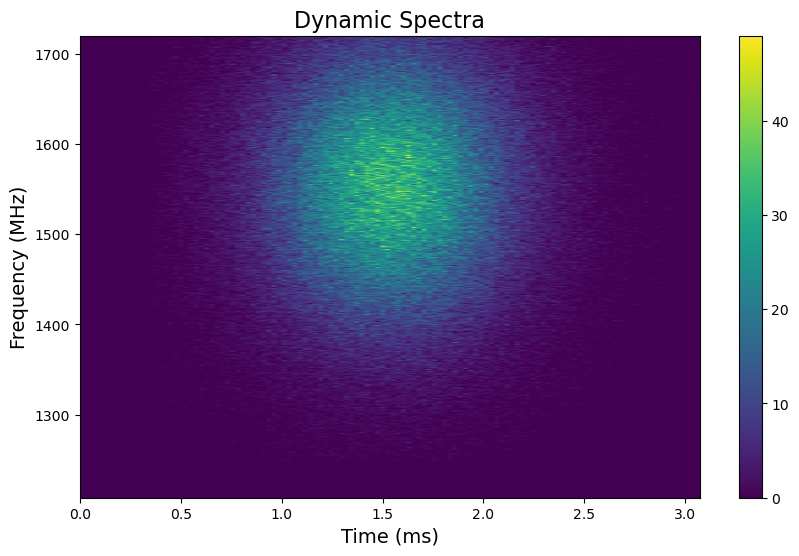

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.00038173733363456403
Frequency: 98.63635487592194
Center Frequency: 1556.3423609254005
(216, 512)


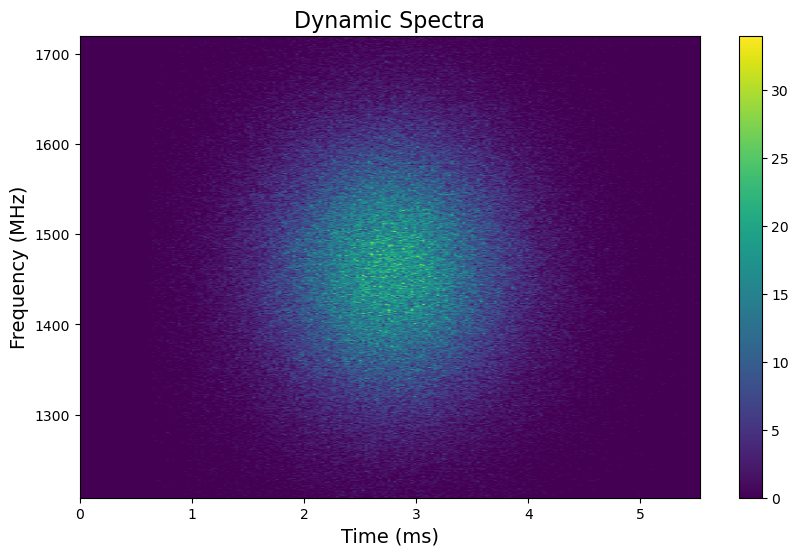

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0006795153255315573
Frequency: 96.34470626691032
Center Frequency: 1462.7920469748879
(176, 512)


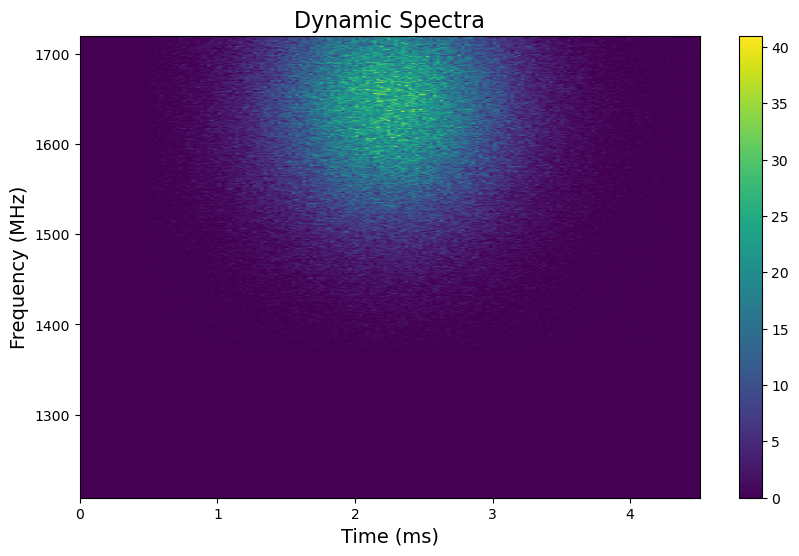

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0005683739503543903
Frequency: 87.74154118812918
Center Frequency: 1649.3066082784385
(232, 512)


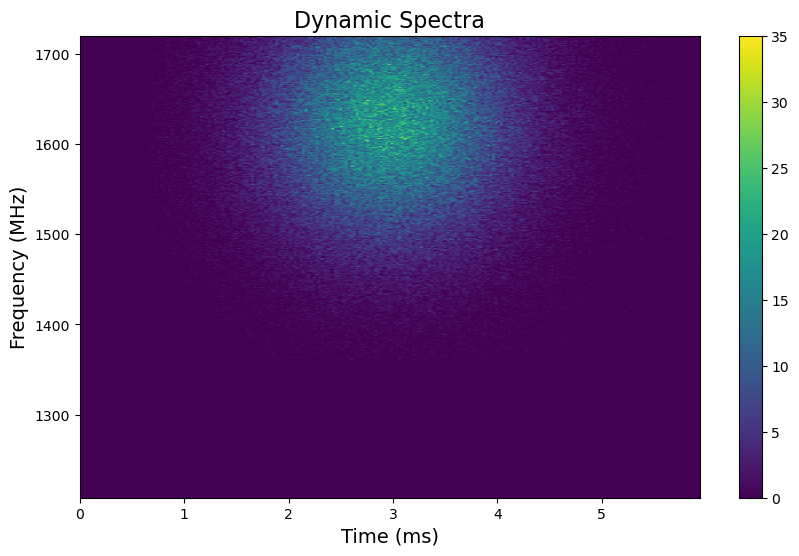

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0007490690747317516
Frequency: 87.4923024033316
Center Frequency: 1630.0173642948114
(288, 512)


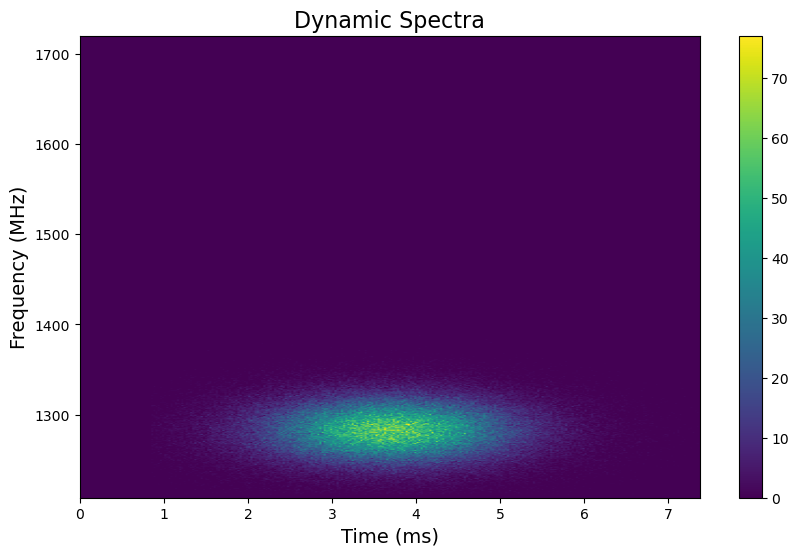

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0009199703043614168
Frequency: 23.463675694012124
Center Frequency: 1283.85777882103
(112, 512)


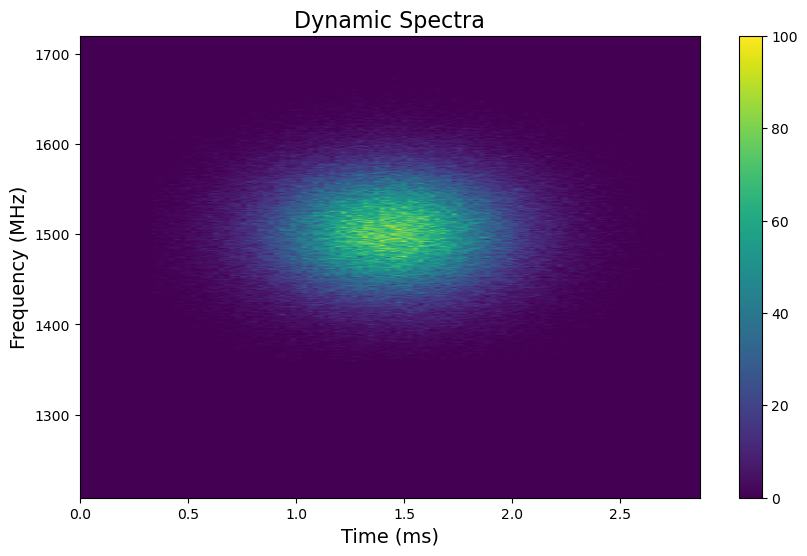

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.00035512578364761254
Frequency: 46.42375780955445
Center Frequency: 1503.1330955493193
(192, 512)


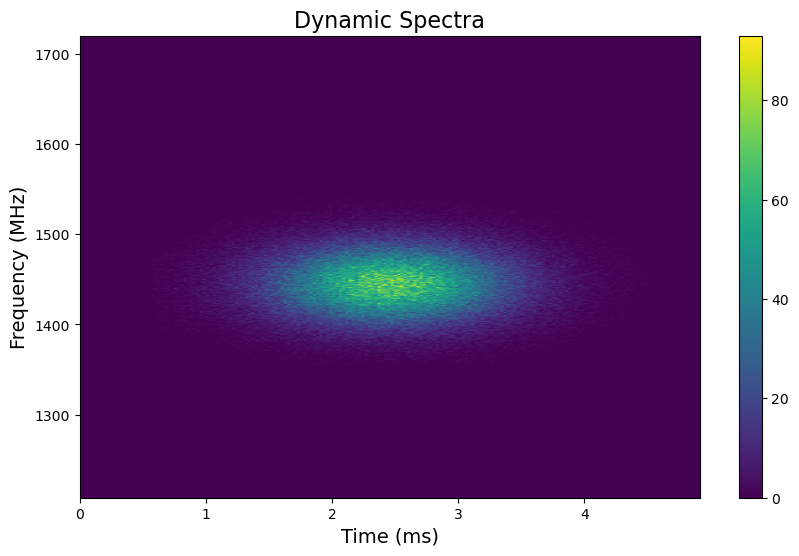

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0006201829824487629
Frequency: 28.660568038182095
Center Frequency: 1446.3297506712543
(232, 512)


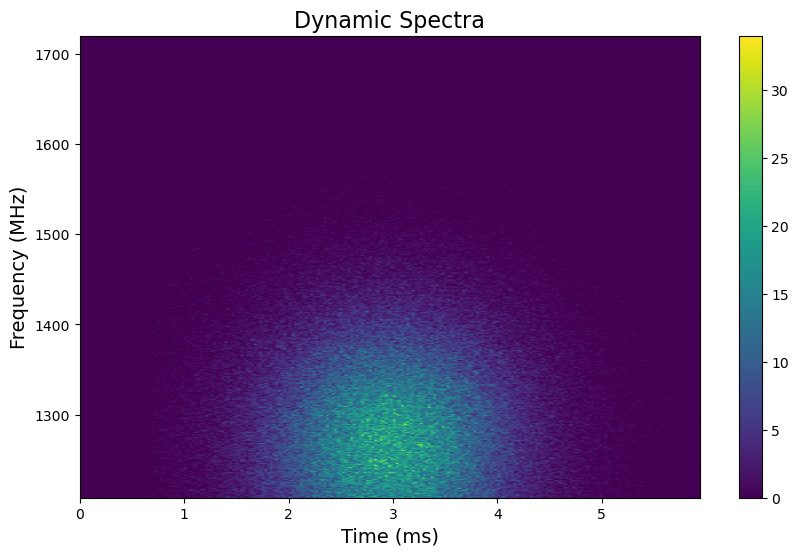

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0007447080467080211
Frequency: 85.65825552666048
Center Frequency: 1265.9886348411346
(320, 512)


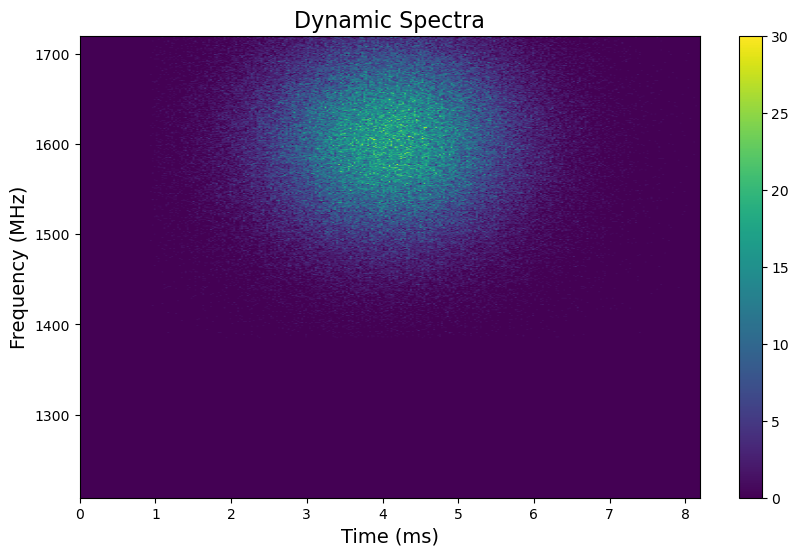

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0010239850789965379
Frequency: 70.78763121779839
Center Frequency: 1606.4791600374283
(152, 512)


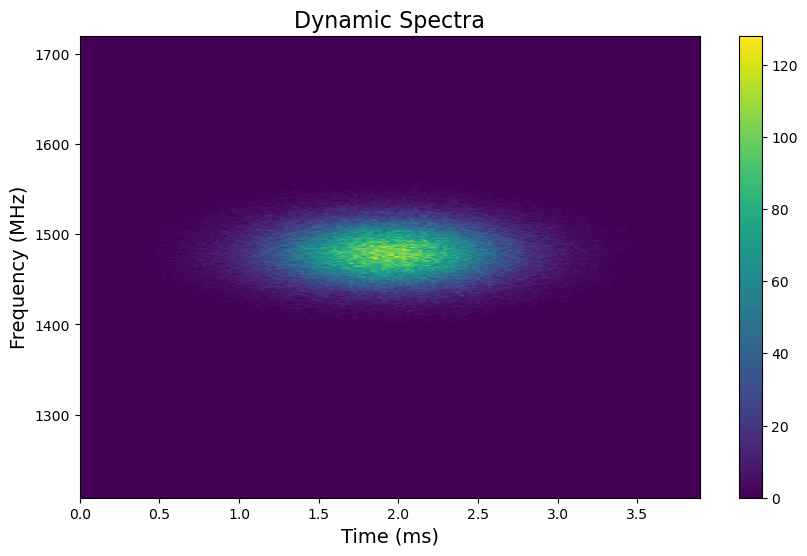

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0004832836205288204
Frequency: 25.22398505141338
Center Frequency: 1479.9979624096927
(144, 512)


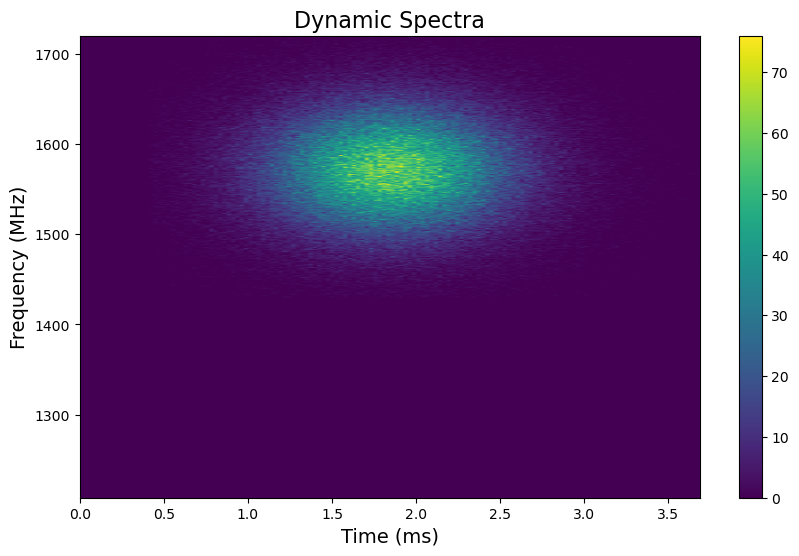

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.00045063674154572654
Frequency: 45.97793279378787
Center Frequency: 1573.4113225925717
(416, 512)


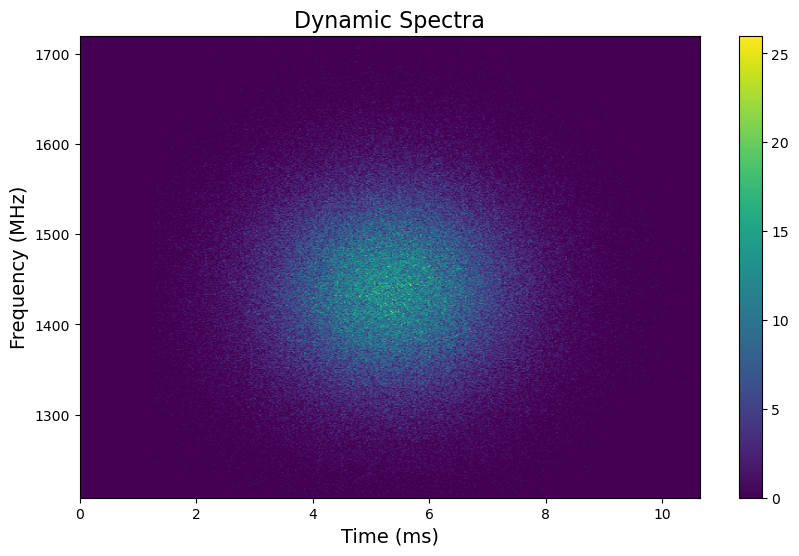

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0013247519775803707
Frequency: 73.95840890407149
Center Frequency: 1439.7420468401388
(456, 512)


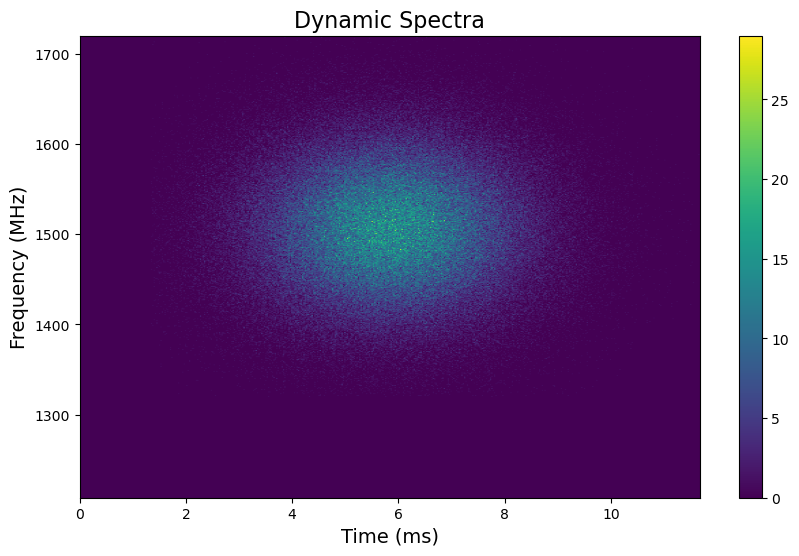

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0014685746887069038
Frequency: 60.22033357803808
Center Frequency: 1506.532780252229
(192, 512)


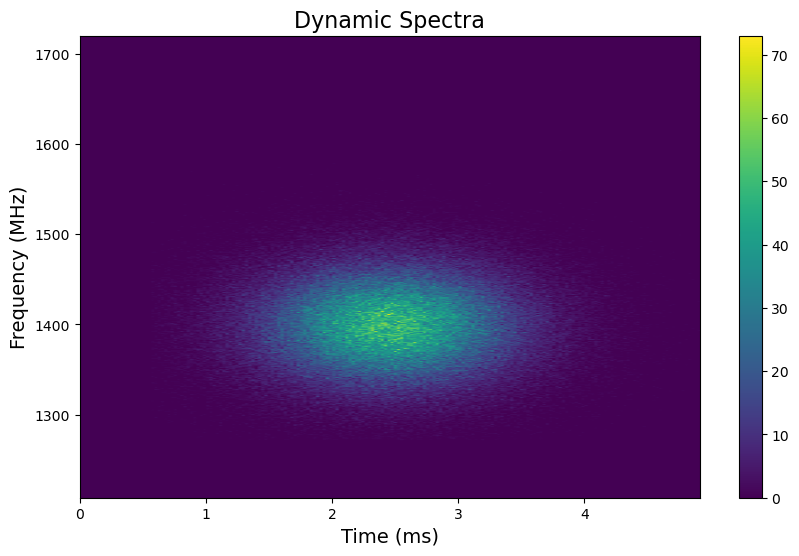

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0006169213787388039
Frequency: 40.90785973338181
Center Frequency: 1399.8816546202206
(112, 512)


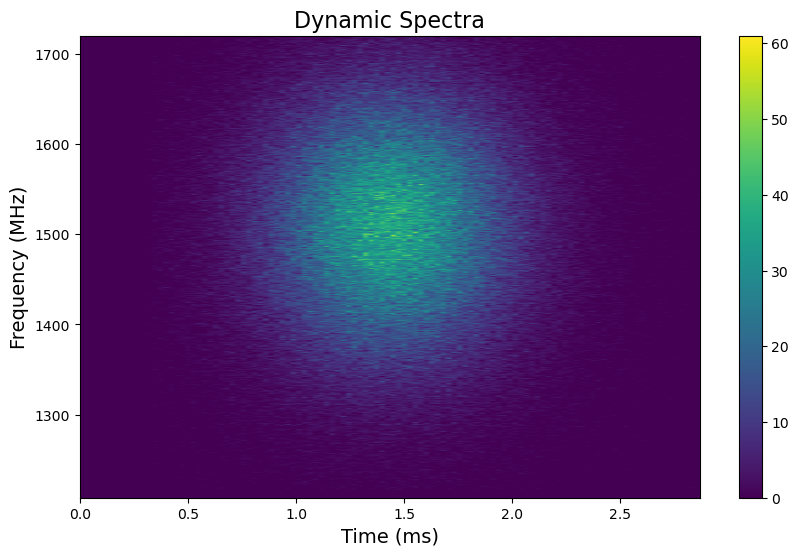

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0003487902064766024
Frequency: 94.72288582195898
Center Frequency: 1511.8808188068385
(336, 512)


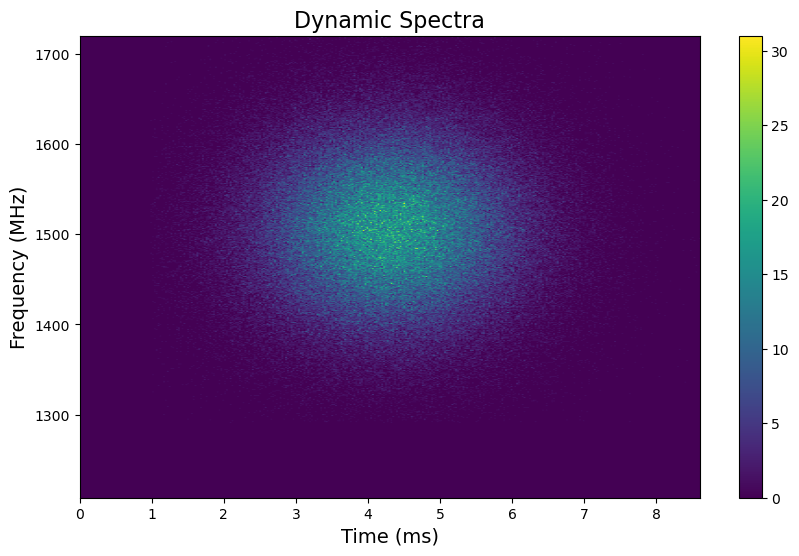

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.001076392884151043
Frequency: 68.648567153633
Center Frequency: 1506.0941882998998
(312, 512)


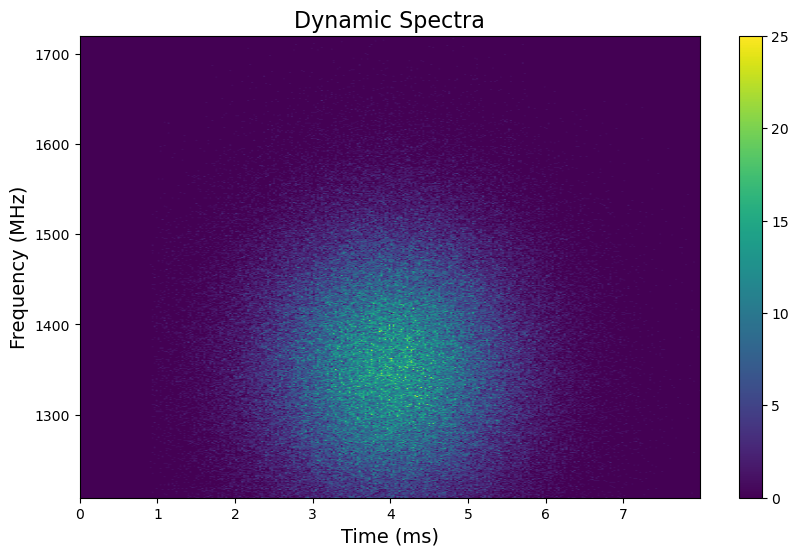

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0010071477469630928
Frequency: 94.67881893271246
Center Frequency: 1353.2249995365496
(200, 512)


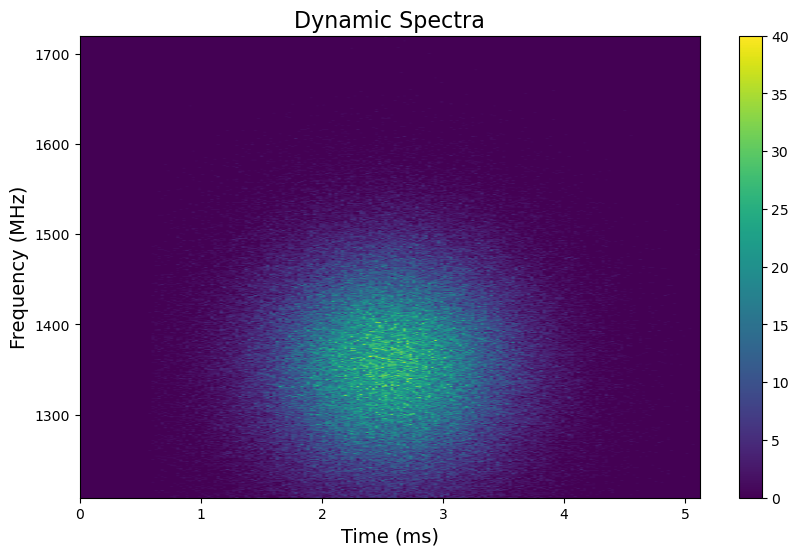

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0006373855607895723
Frequency: 78.8088439041653
Center Frequency: 1357.4978021177462
(264, 512)


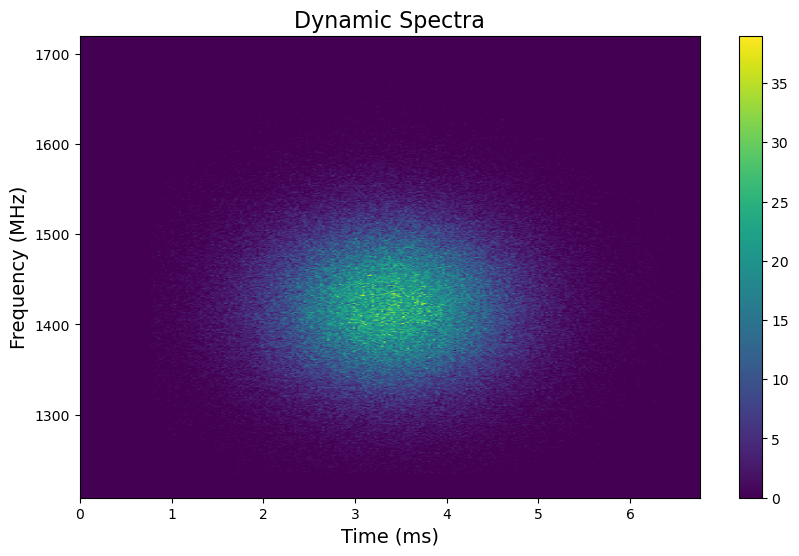

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0008467380252382184
Frequency: 60.05902296169879
Center Frequency: 1420.5939613186774
(448, 512)


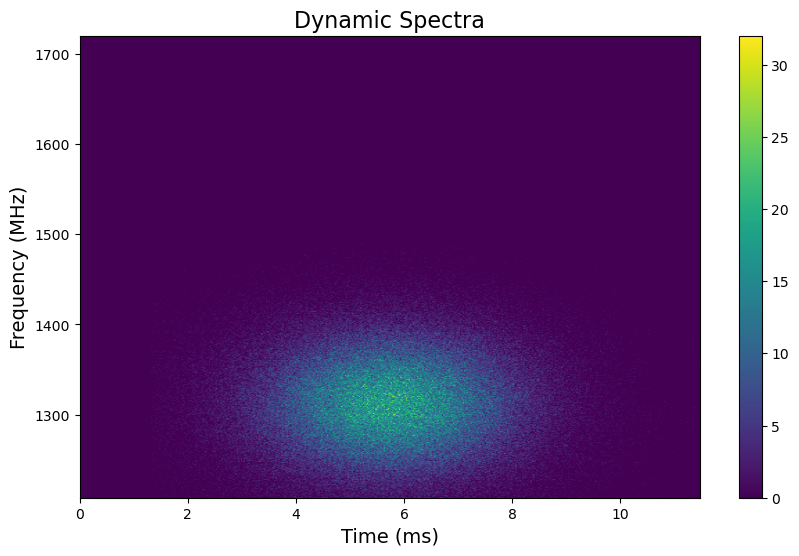

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0014303736124802223
Frequency: 48.48164696584375
Center Frequency: 1312.5983765742794
(312, 512)


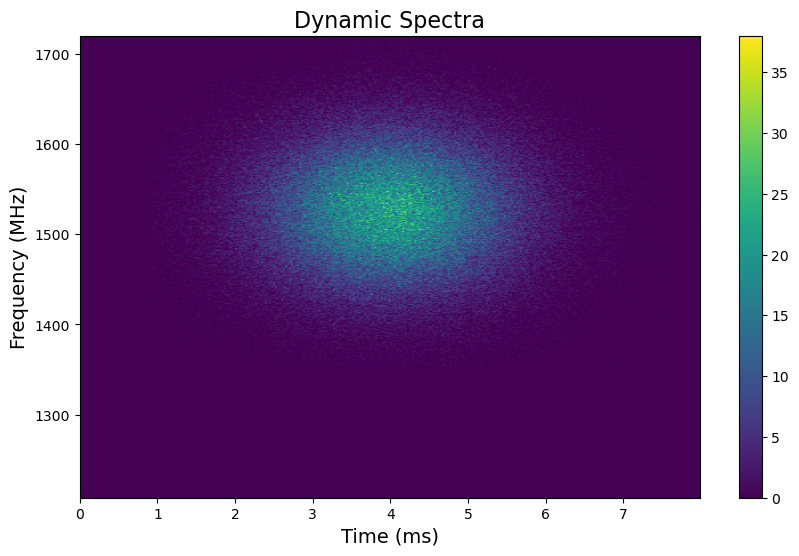

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0009972997748557587
Frequency: 55.77856906720643
Center Frequency: 1527.0910559628546
(216, 512)


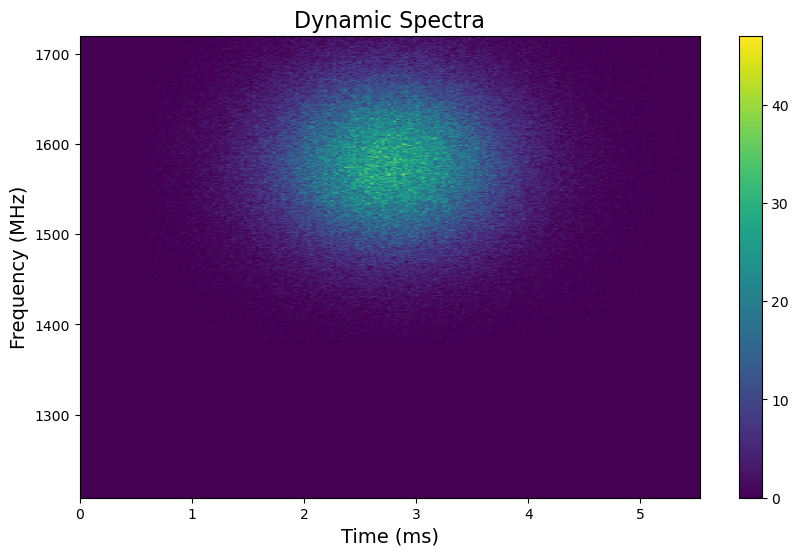

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0006823342848453705
Frequency: 64.40532800841856
Center Frequency: 1580.1758010514156
(176, 512)


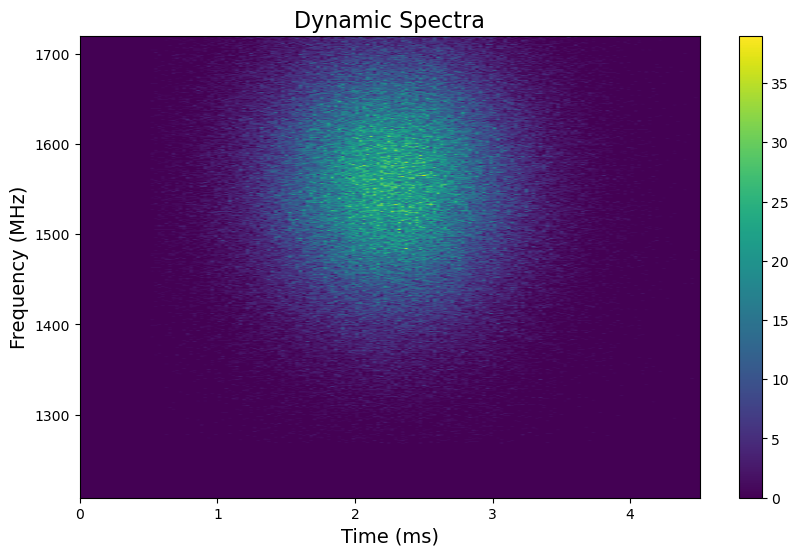

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0005726655543876717
Frequency: 94.32133305781076
Center Frequency: 1559.7138091587487
(320, 512)


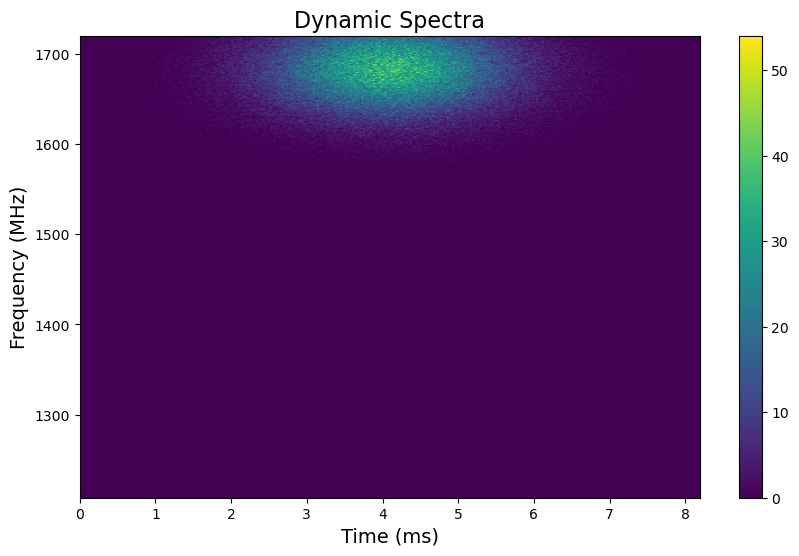

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0010344003363831164
Frequency: 33.62546093067667
Center Frequency: 1685.0771417972664
(336, 512)


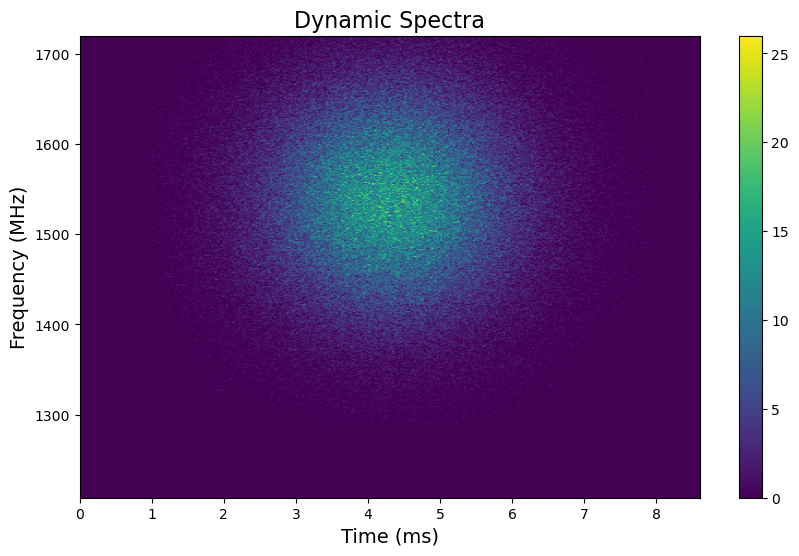

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0010854130036380364
Frequency: 80.38389165931089
Center Frequency: 1538.7745672891506
(424, 512)


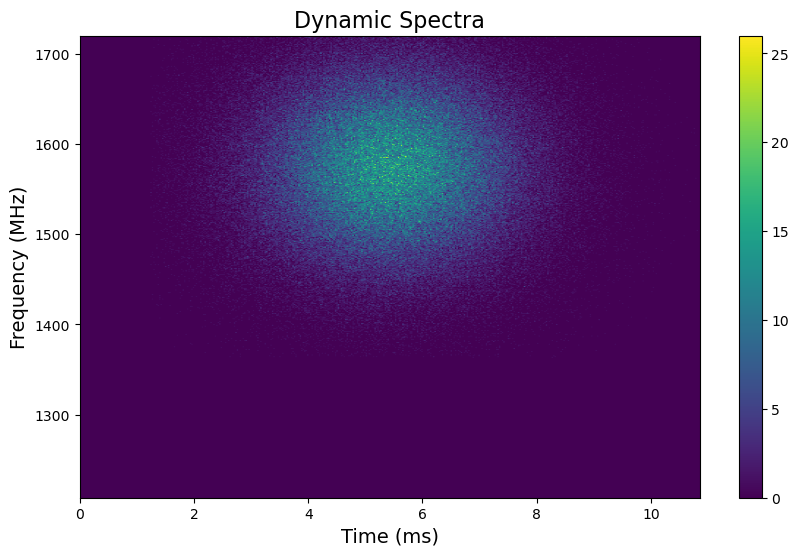

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0013689468381805
Frequency: 67.82881332224704
Center Frequency: 1575.0789298657955
(208, 512)


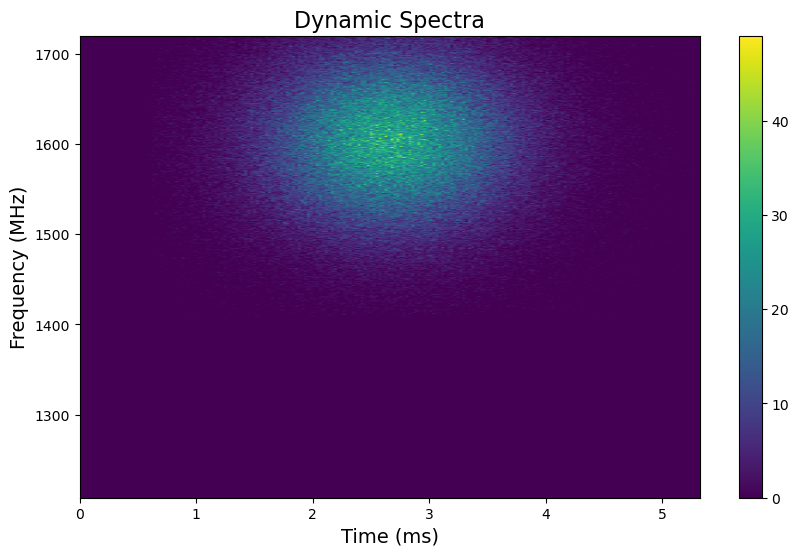

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0006619056675182782
Frequency: 62.5762969482781
Center Frequency: 1605.3691829269458
(96, 512)


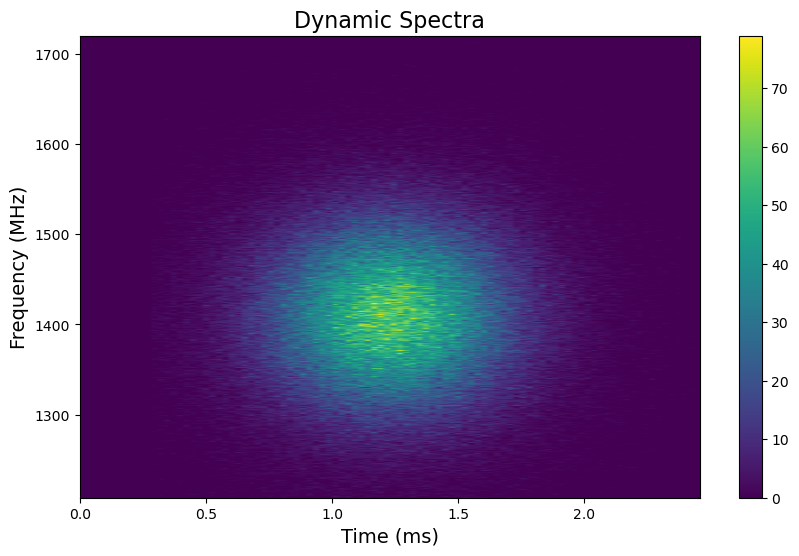

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0003024991880190371
Frequency: 68.91167649993625
Center Frequency: 1411.3146153006837
(336, 512)


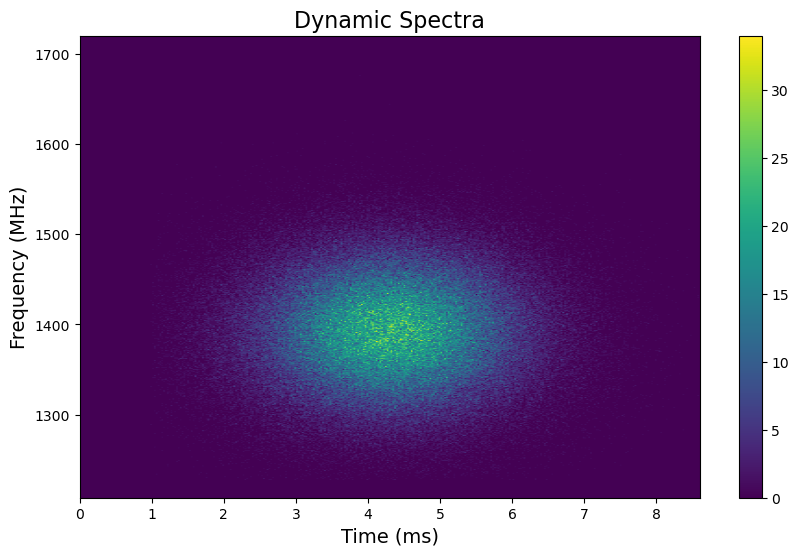

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0010833643352433369
Frequency: 52.80856204457492
Center Frequency: 1393.4320971533307
(264, 512)


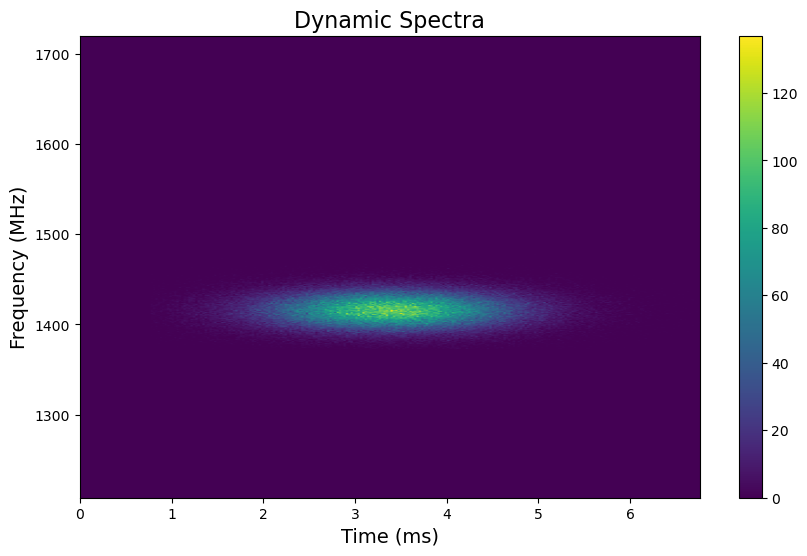

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0008335212153403688
Frequency: 13.6094162759717
Center Frequency: 1417.0992282512007
(328, 512)


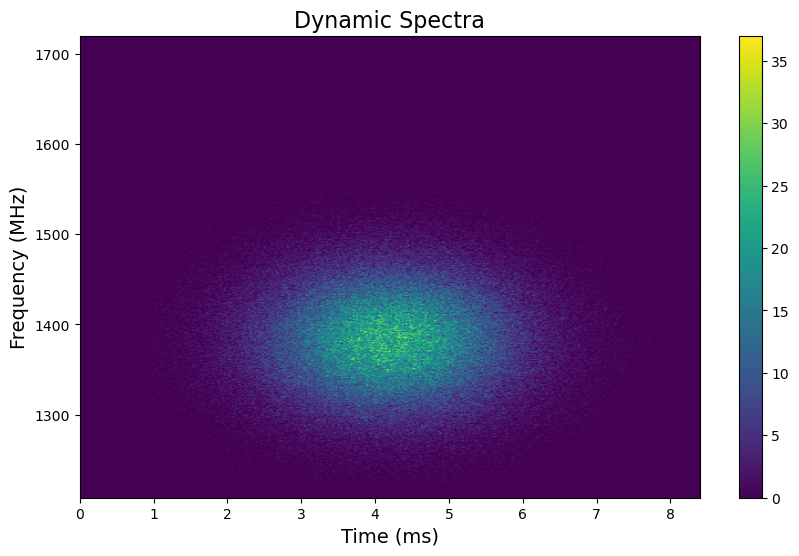

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0010616249671592812
Frequency: 50.898341263582665
Center Frequency: 1383.6461097068004
(264, 512)


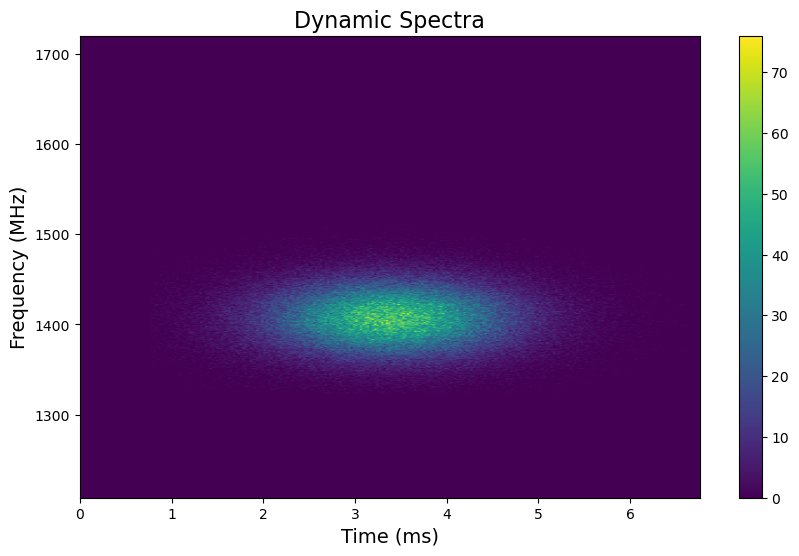

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0008471037288782362
Frequency: 27.383764276698475
Center Frequency: 1408.2071795473162
(264, 512)


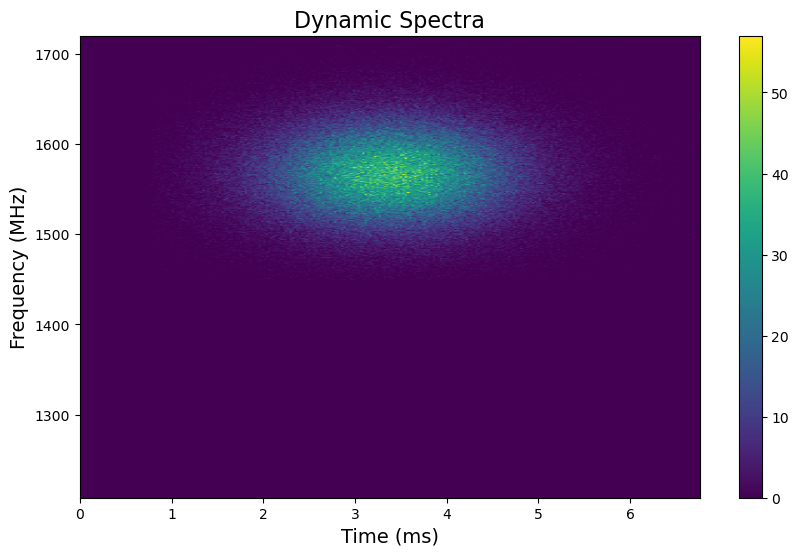

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0008468633467512026
Frequency: 38.31851082158031
Center Frequency: 1568.3599149056017
(384, 512)


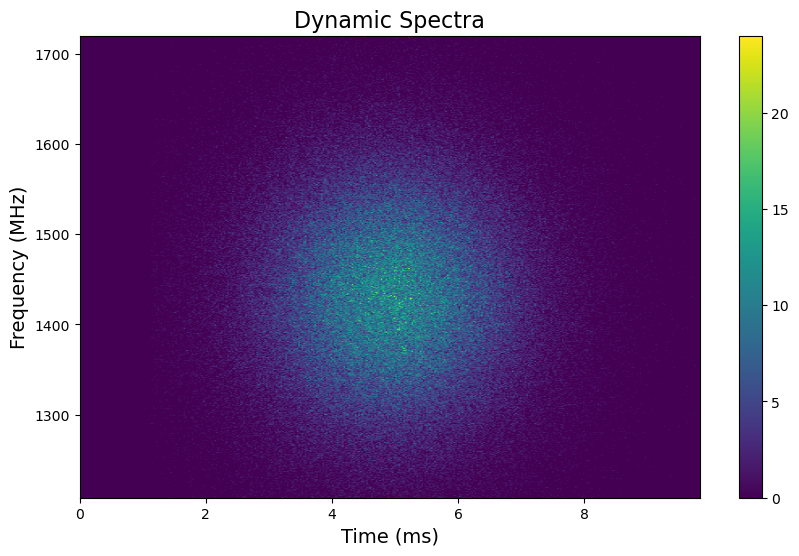

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0012290571352176157
Frequency: 92.39688873183319
Center Frequency: 1432.21405315557
(376, 512)


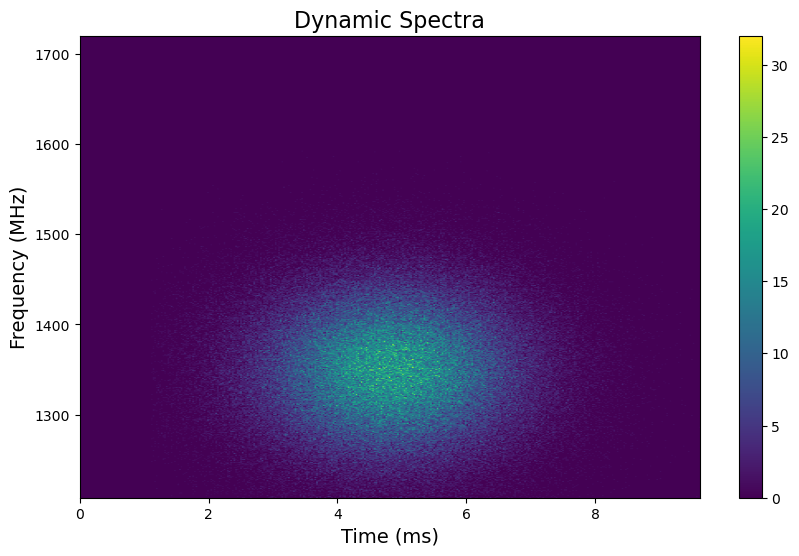

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0011921977023570314
Frequency: 58.373103796152705
Center Frequency: 1350.3562376717914
(192, 512)


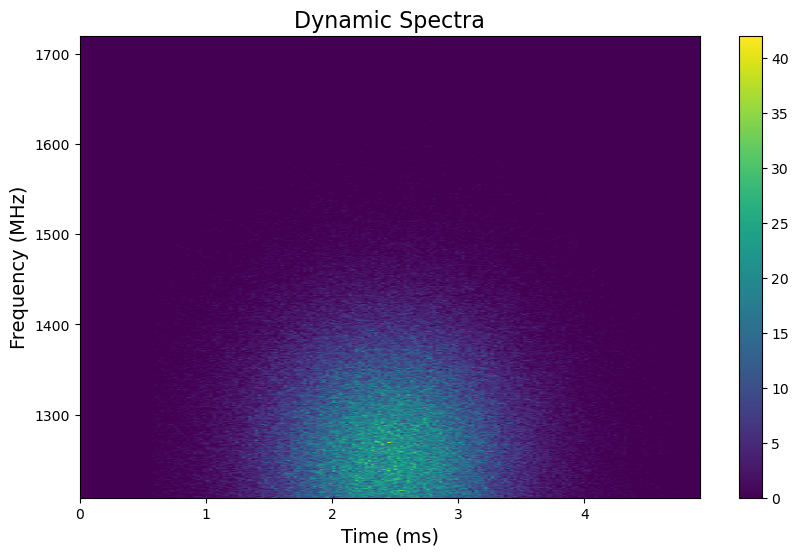

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0006106588622869468
Frequency: 90.74170122335487
Center Frequency: 1250.9973259429596
(440, 512)


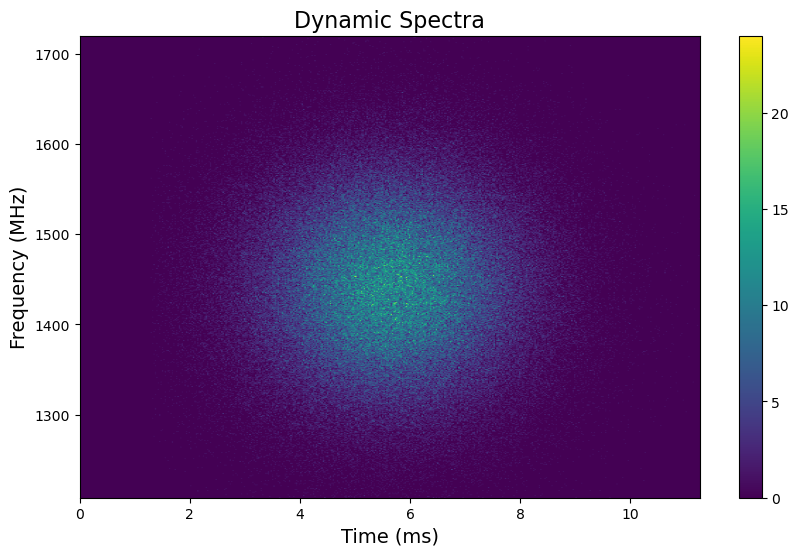

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0014204071923302696
Frequency: 77.87114346136549
Center Frequency: 1441.6174167405613
(328, 512)


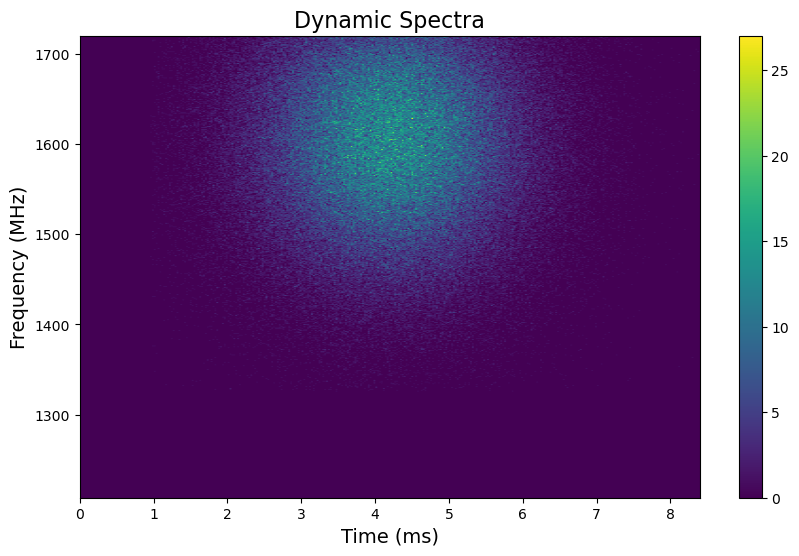

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0010381761278336918
Frequency: 90.63024533157852
Center Frequency: 1608.5014726668946
(64, 512)


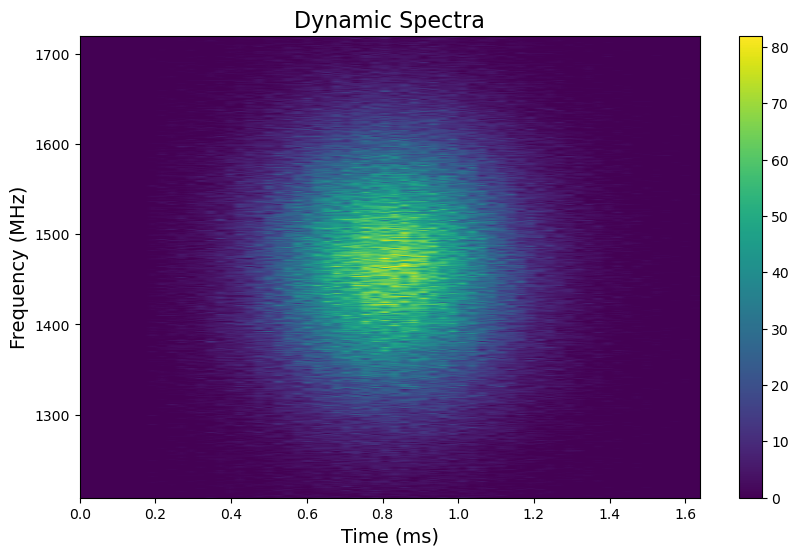

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0002002080136727833
Frequency: 94.77140244142007
Center Frequency: 1467.3136659545696
(368, 512)


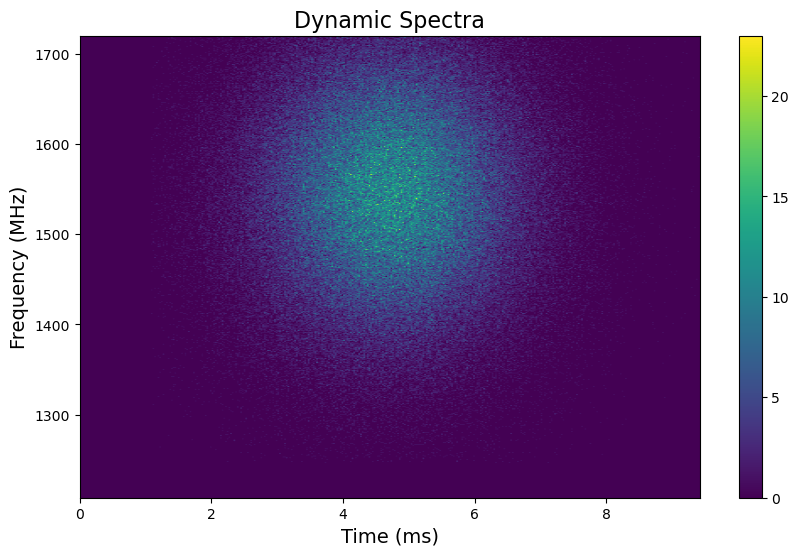

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.001176882963010707
Frequency: 97.4997100447437
Center Frequency: 1547.872412481791
(240, 512)


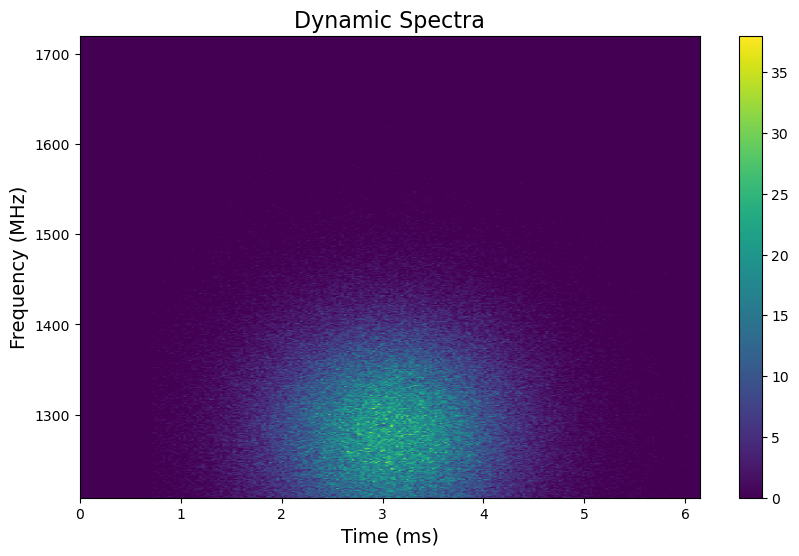

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0007568265637130737
Frequency: 75.88153750853294
Center Frequency: 1279.3238803485358
(200, 512)


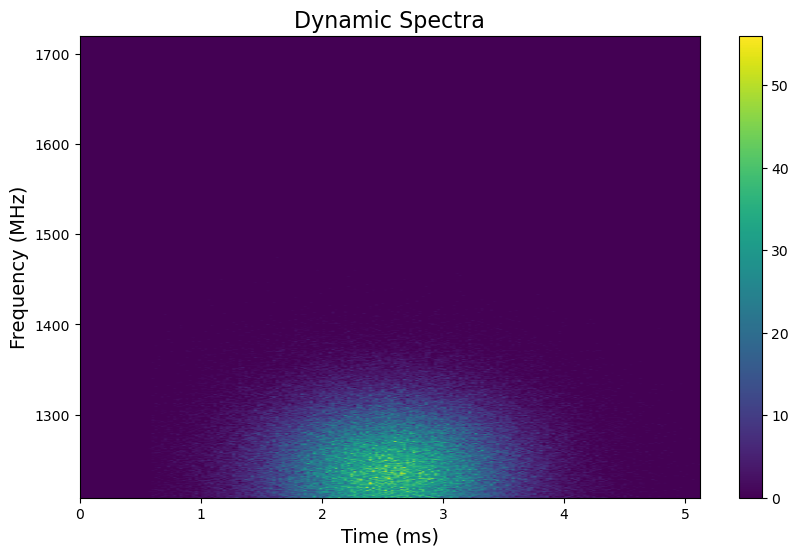

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0006500542241829796
Frequency: 53.463858318285595
Center Frequency: 1234.3701513313513
(224, 512)


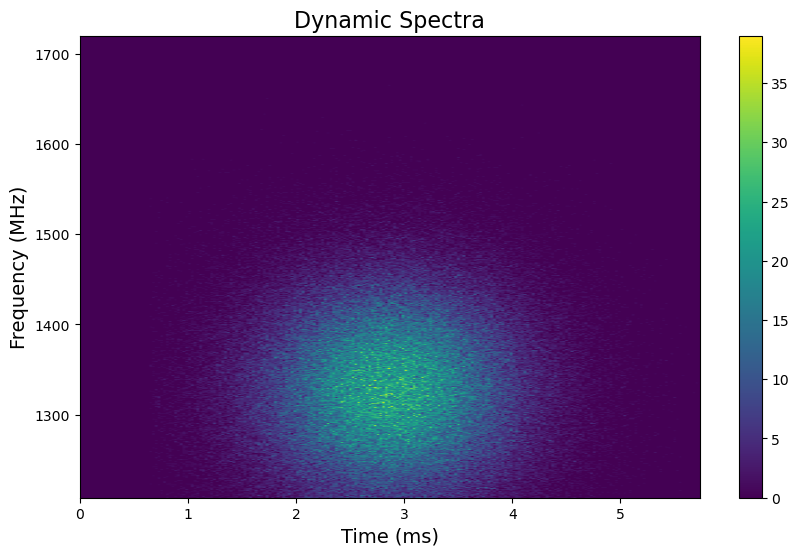

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0007172520814446234
Frequency: 73.7217714961074
Center Frequency: 1326.5162708712583
(136, 512)


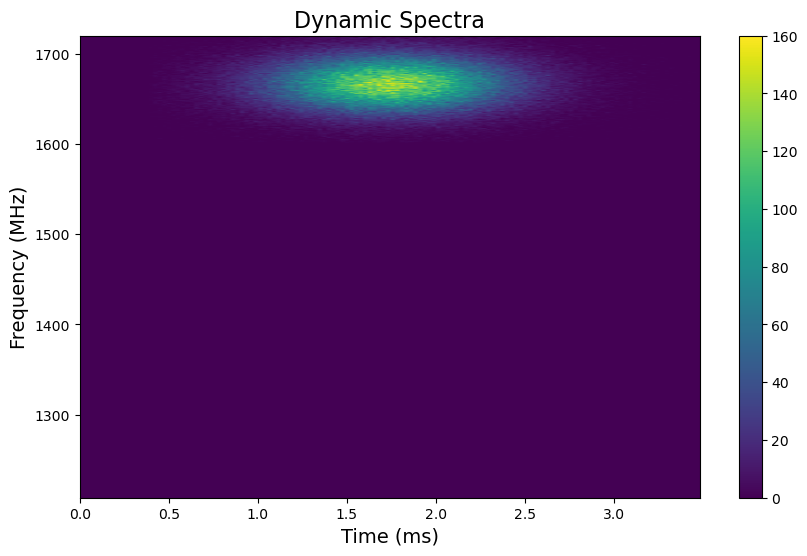

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0004380448046803373
Frequency: 21.001344665456415
Center Frequency: 1668.4340719591555
(336, 512)


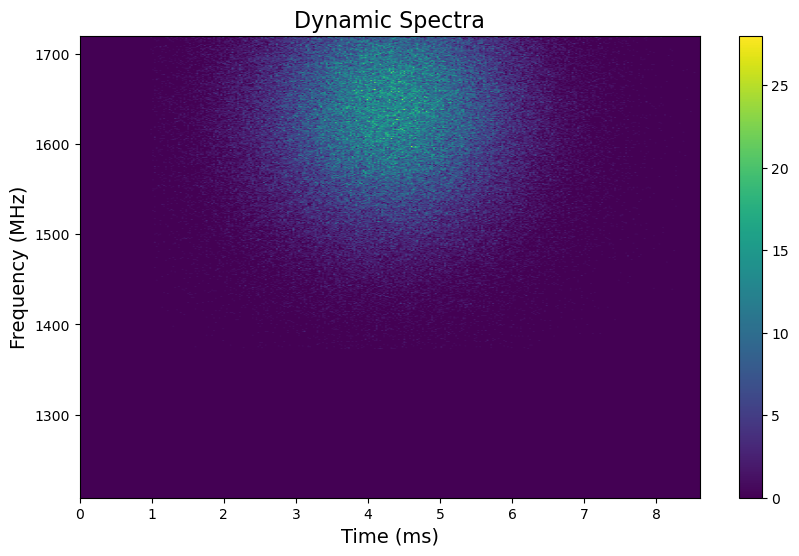

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0010647539602821811
Frequency: 87.25049771476752
Center Frequency: 1642.53836599653
(352, 512)


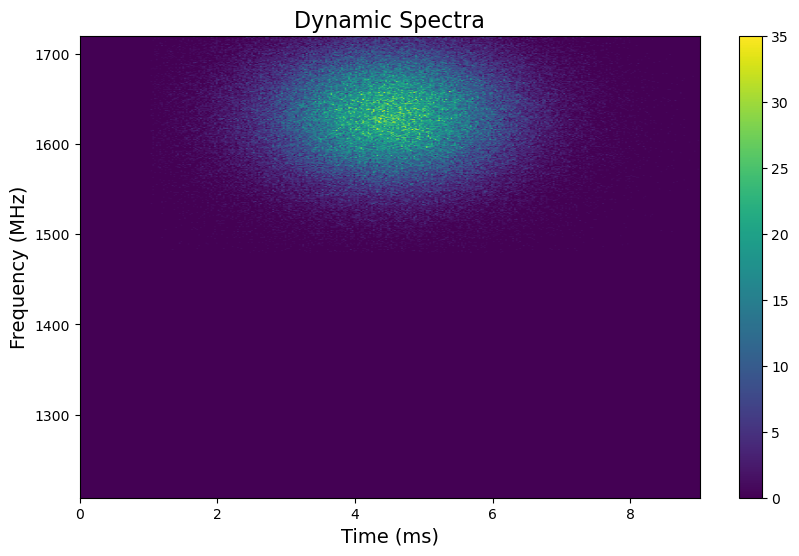

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0011346579443386048
Frequency: 48.735481060832946
Center Frequency: 1633.4358455356619
(368, 512)


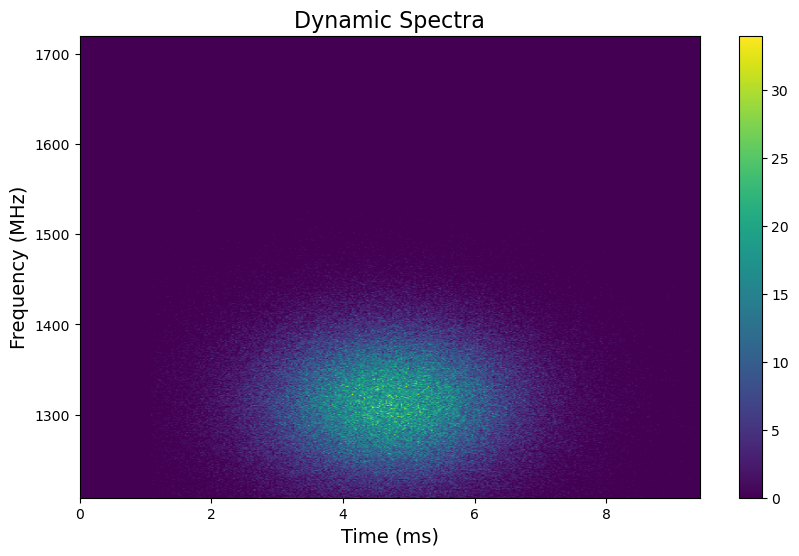

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.00116663269623849
Frequency: 53.27601461095184
Center Frequency: 1314.1990461012724
(256, 512)


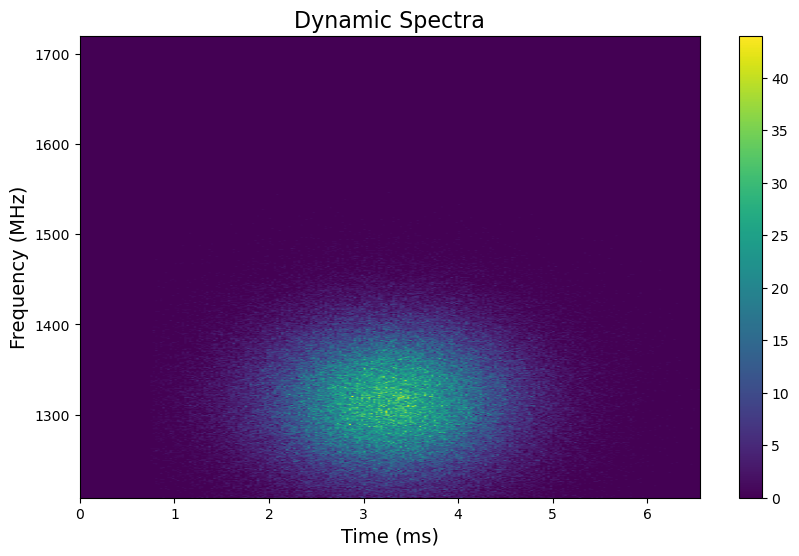

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.000824116903418772
Frequency: 53.74267295224652
Center Frequency: 1315.837395565904
(416, 512)


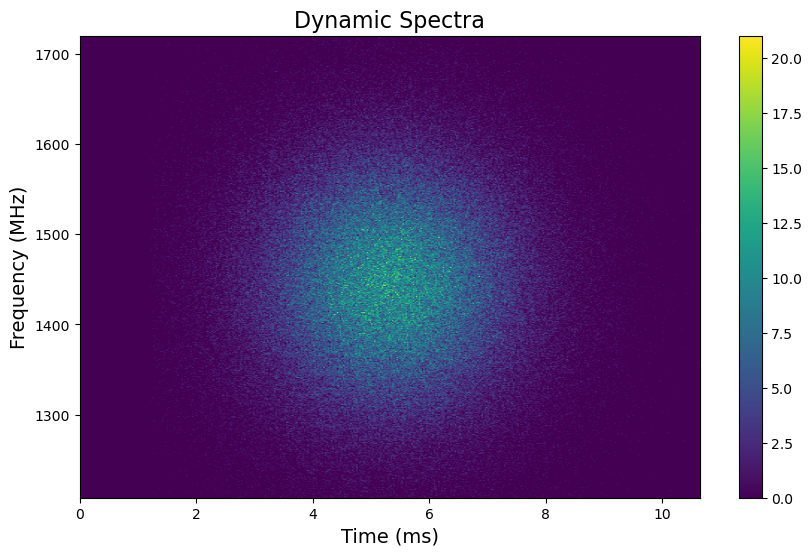

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0013347146462828088
Frequency: 87.62601516703118
Center Frequency: 1446.2603955684285
(360, 512)


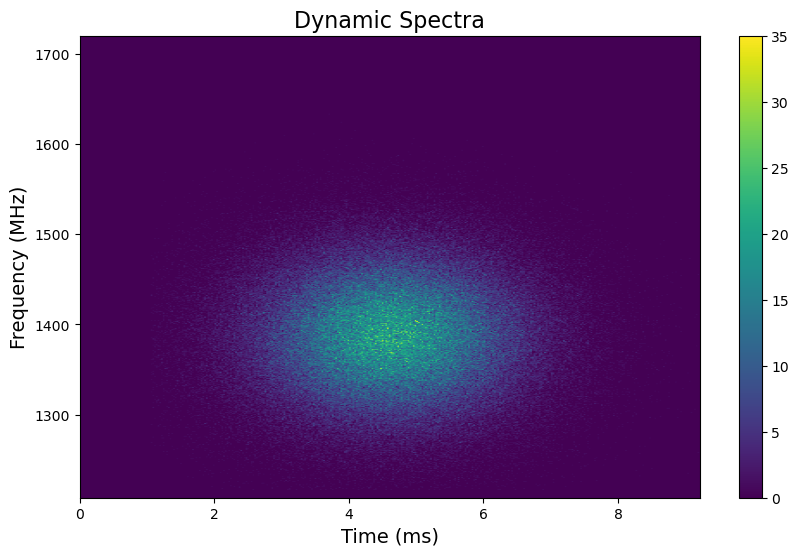

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0011619110368693575
Frequency: 55.215974830347584
Center Frequency: 1388.4840595265543
(328, 512)


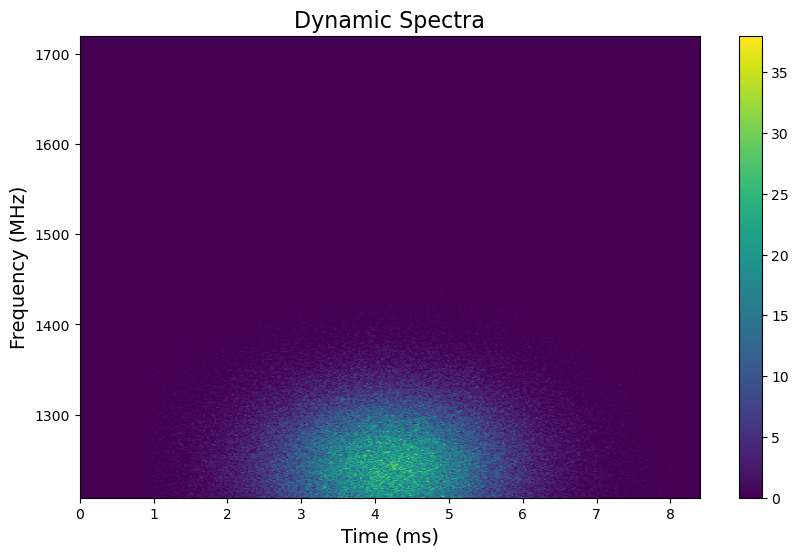

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0010547745879856154
Frequency: 52.89612488847269
Center Frequency: 1241.6583328257857
(288, 512)


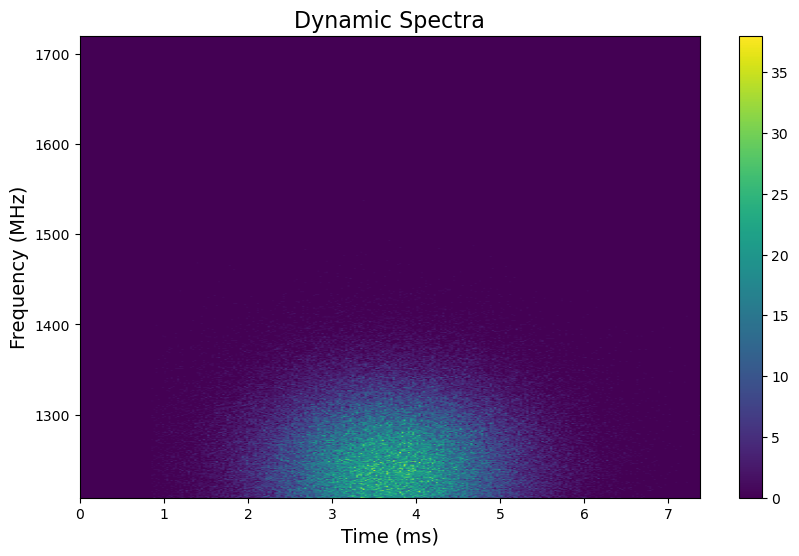

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0009178296120456599
Frequency: 59.773415658423815
Center Frequency: 1236.3608151558897
(344, 512)


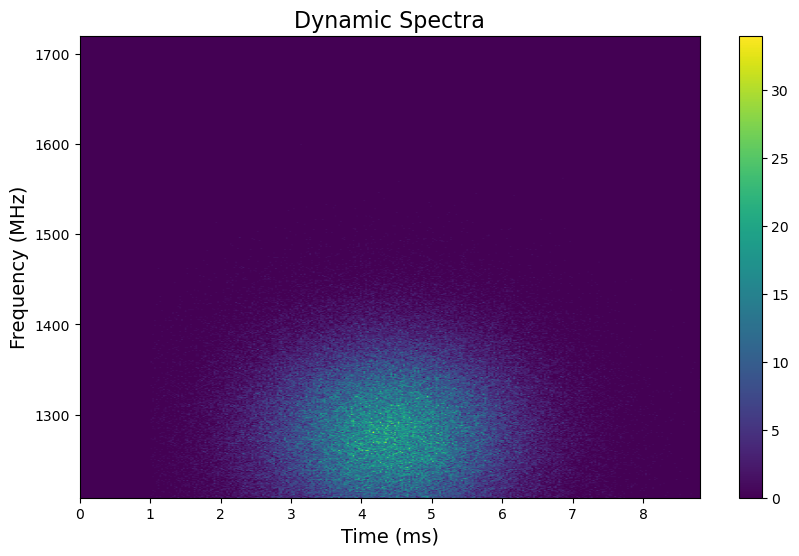

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.001090521327978133
Frequency: 64.9349035670304
Center Frequency: 1276.933929052964
(368, 512)


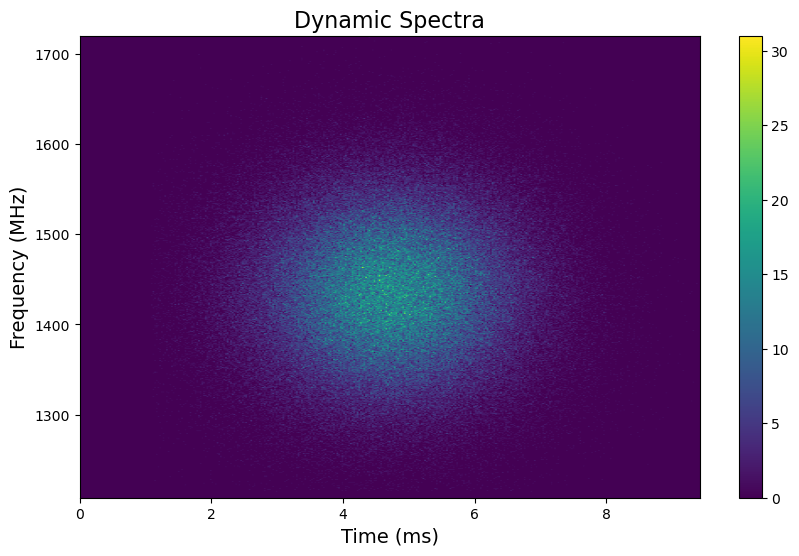

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.001180005556832082
Frequency: 71.05061414723501
Center Frequency: 1436.1126192648899
(144, 512)


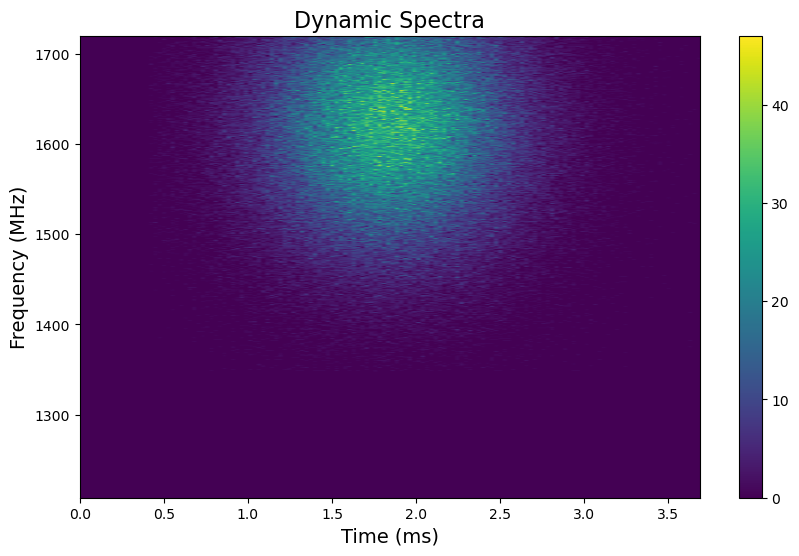

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.000451051873987469
Frequency: 88.76739169086306
Center Frequency: 1625.2230355948138
(120, 512)


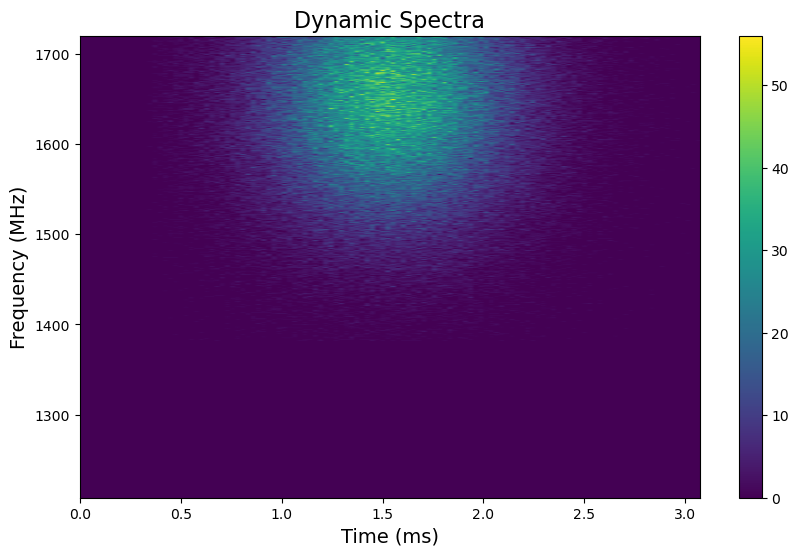

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.00037892005554814354
Frequency: 89.27081607592936
Center Frequency: 1657.5094520394741
(232, 512)


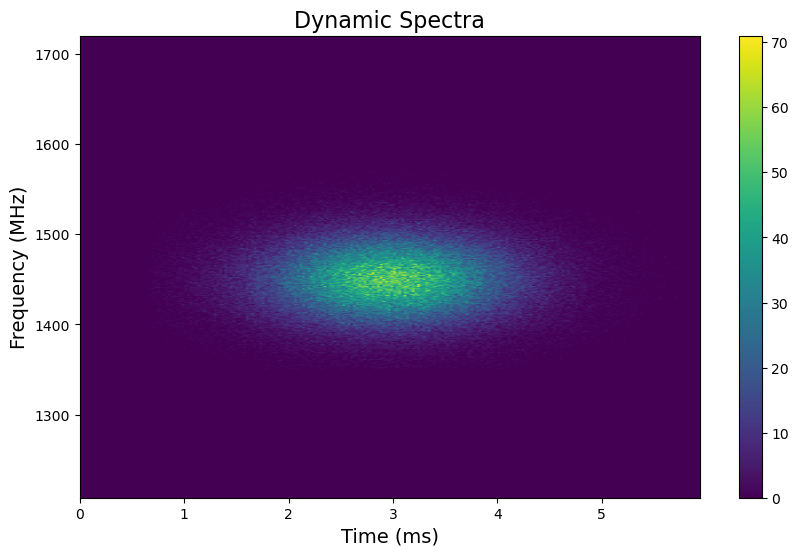

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0007317787690932079
Frequency: 32.43690835519686
Center Frequency: 1450.7361494332033
(296, 512)


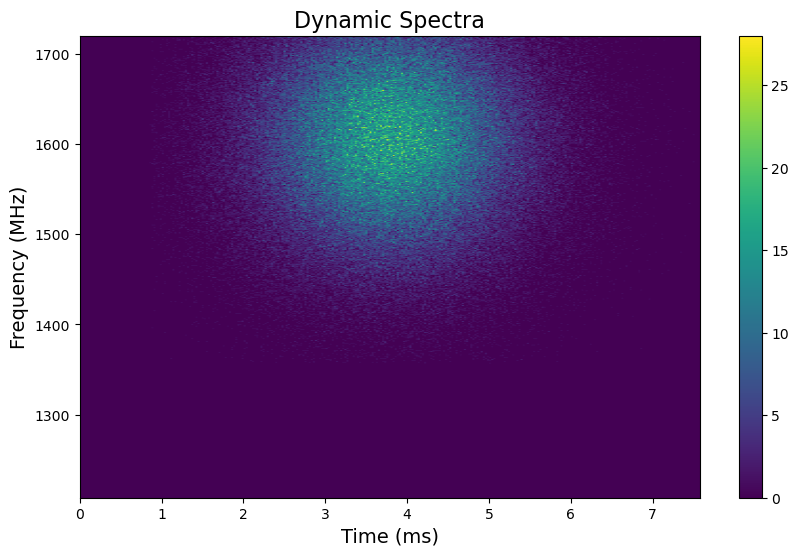

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0009453207551859086
Frequency: 80.85756904474982
Center Frequency: 1609.0100657834546
(200, 512)


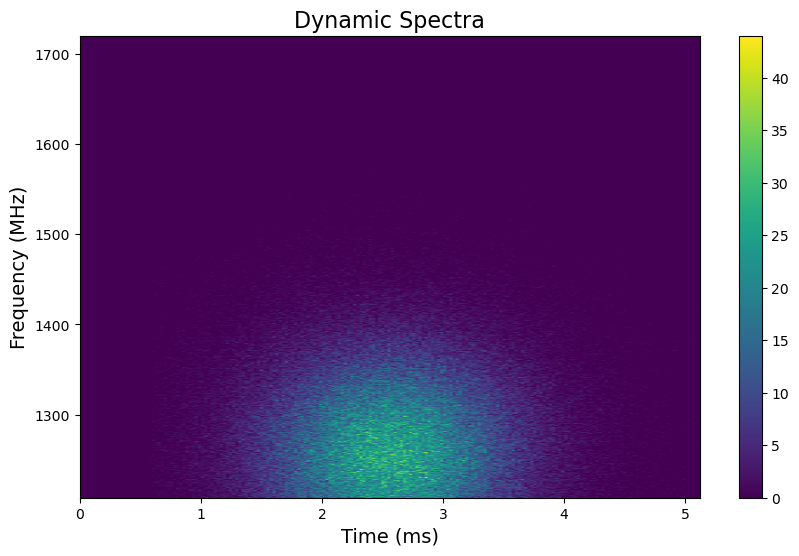

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.000636439625080244
Frequency: 73.28465885485755
Center Frequency: 1253.6420024143413
(232, 512)


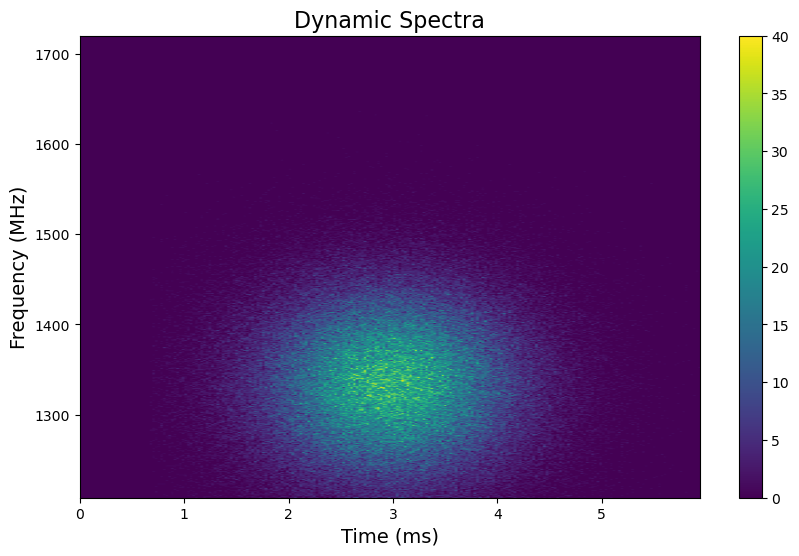

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.000741113849307185
Frequency: 65.17783841939175
Center Frequency: 1334.9823985231678
(304, 512)


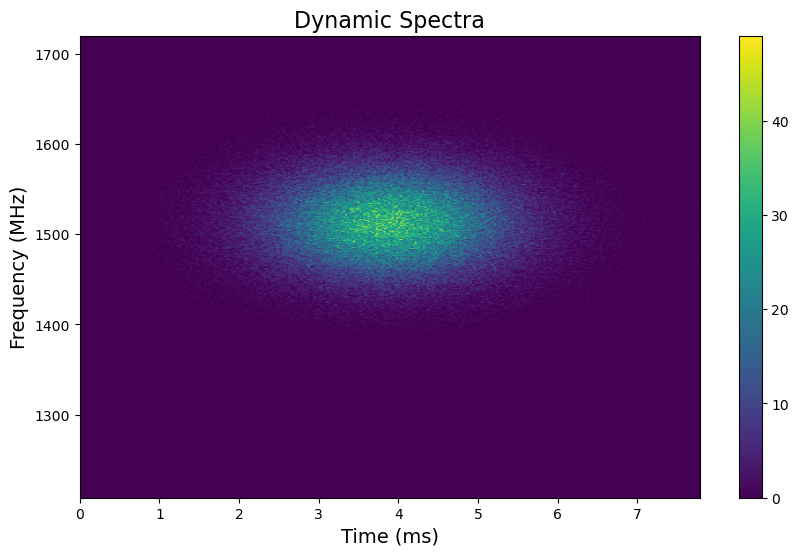

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0009690949413495799
Frequency: 39.34894371021575
Center Frequency: 1514.1001912057318
(352, 512)


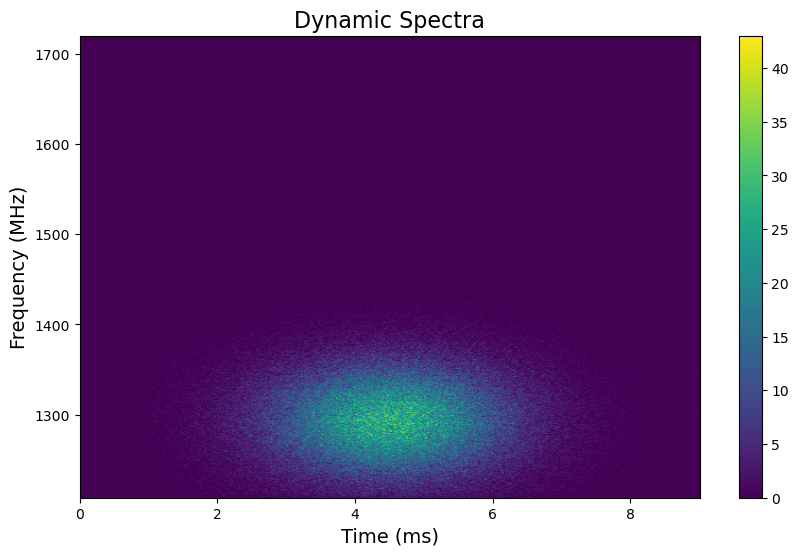

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0011251435485242272
Frequency: 40.708878490721304
Center Frequency: 1295.146266761538
(320, 512)


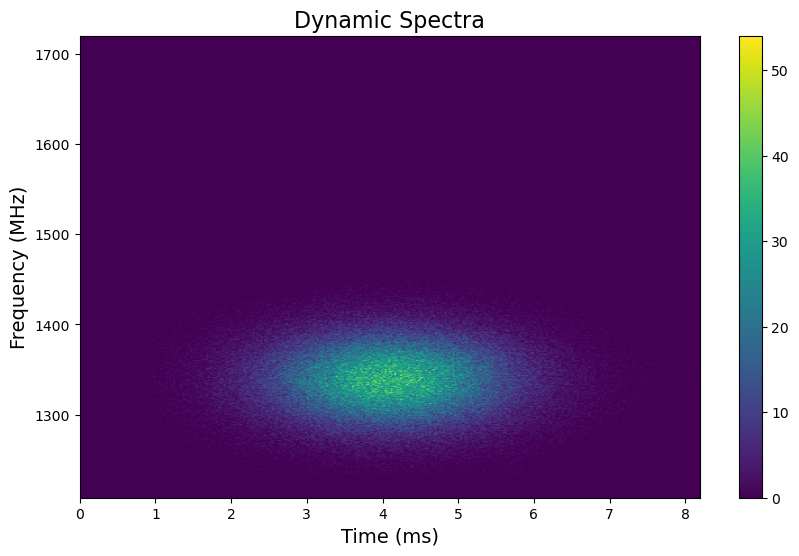

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0010317756085592208
Frequency: 33.66945573735008
Center Frequency: 1340.3080662211642
(152, 512)


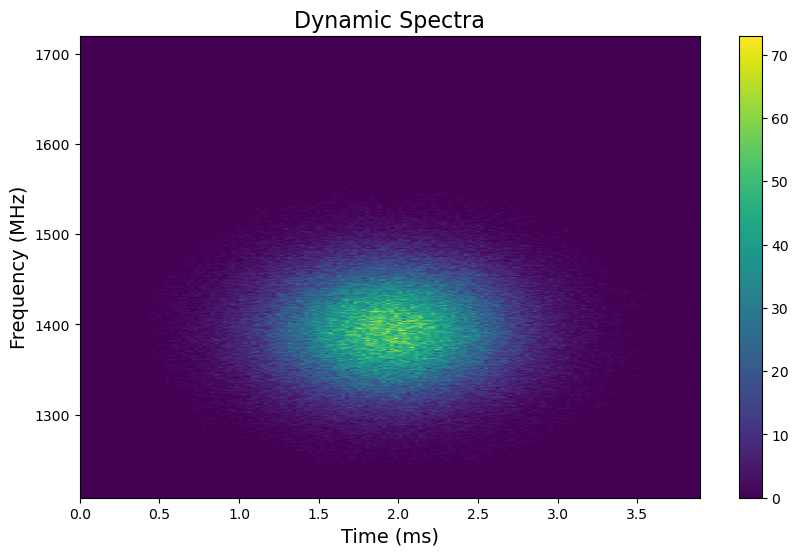

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0004911781143744326
Frequency: 47.6839744843339
Center Frequency: 1395.2572531837916
(296, 512)


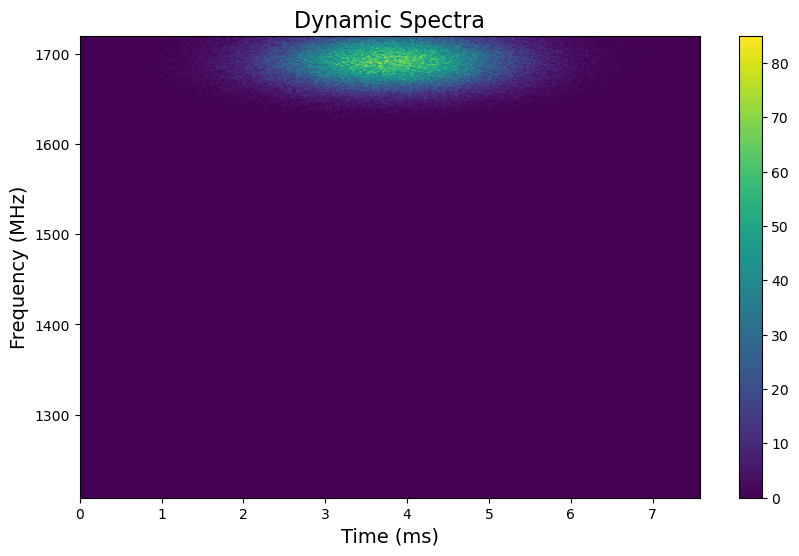

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0009415687340935228
Frequency: 20.71250344413655
Center Frequency: 1692.840966799912
(152, 512)


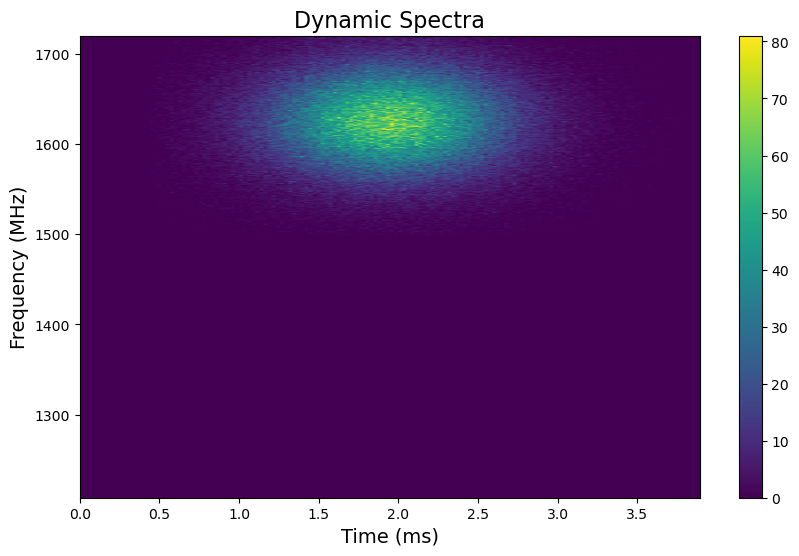

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.000476220974161605
Frequency: 41.46773661449579
Center Frequency: 1627.1148982027526
(32, 512)


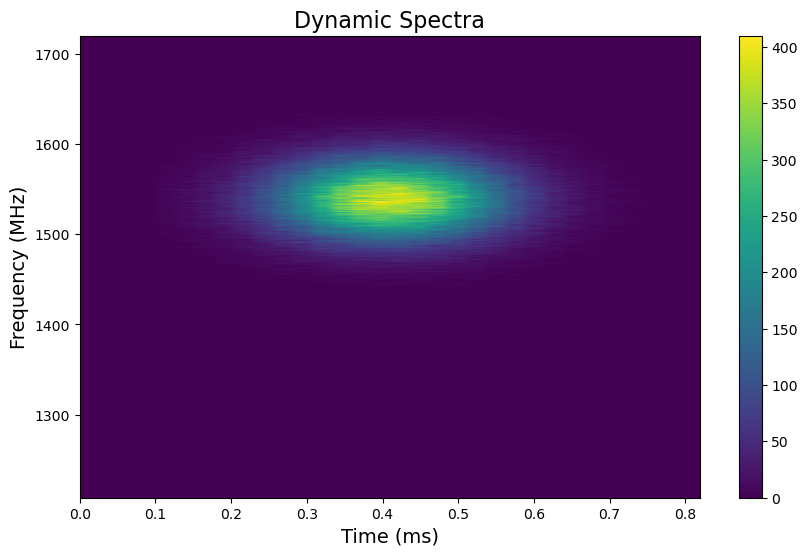

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 9.080247930175265e-05
Frequency: 31.312477290146234
Center Frequency: 1539.989004907123
(360, 512)


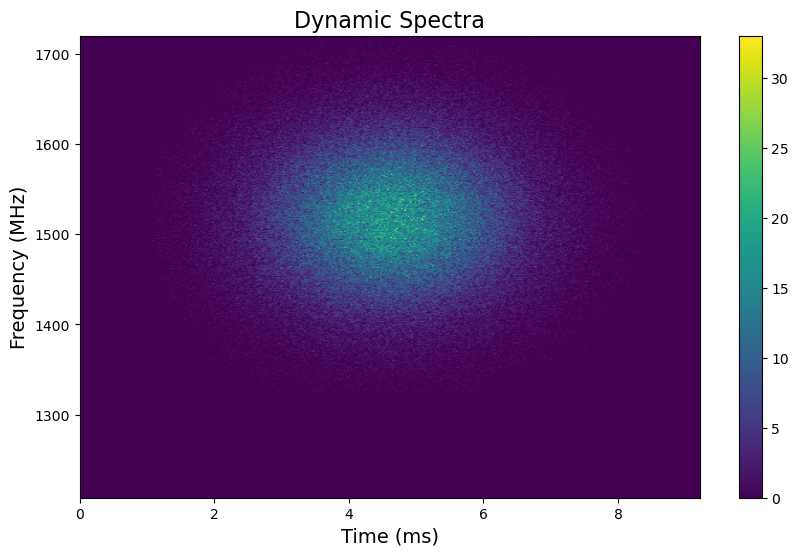

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0011470444305191683
Frequency: 61.819161785808475
Center Frequency: 1518.485839593495
(184, 512)


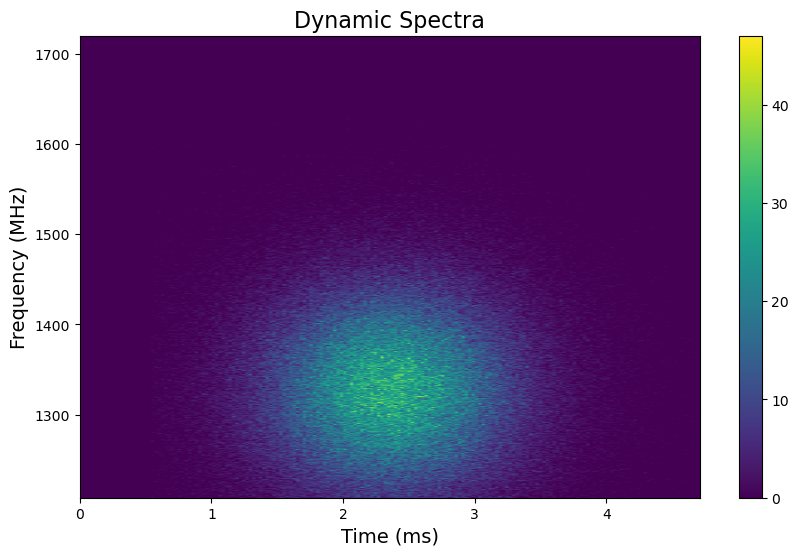

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0005903687454347395
Frequency: 72.17763301877517
Center Frequency: 1327.5933354962415
(344, 512)


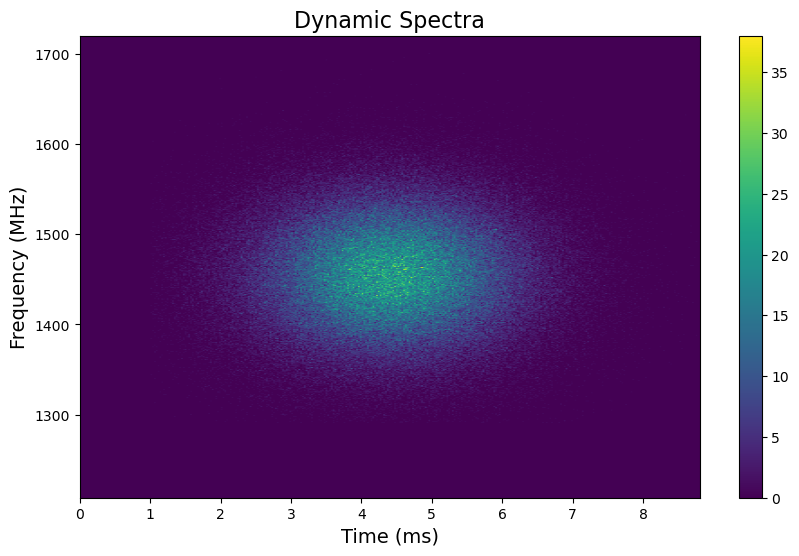

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0010920799742759257
Frequency: 52.57869790864222
Center Frequency: 1456.1755279950003
(272, 512)


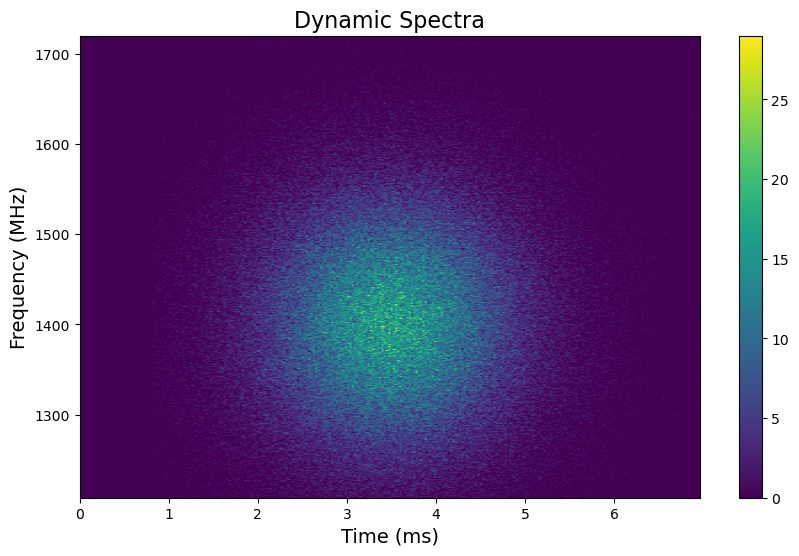

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0008628267816550904
Frequency: 87.25776117437422
Center Frequency: 1402.7979562647395
(232, 512)


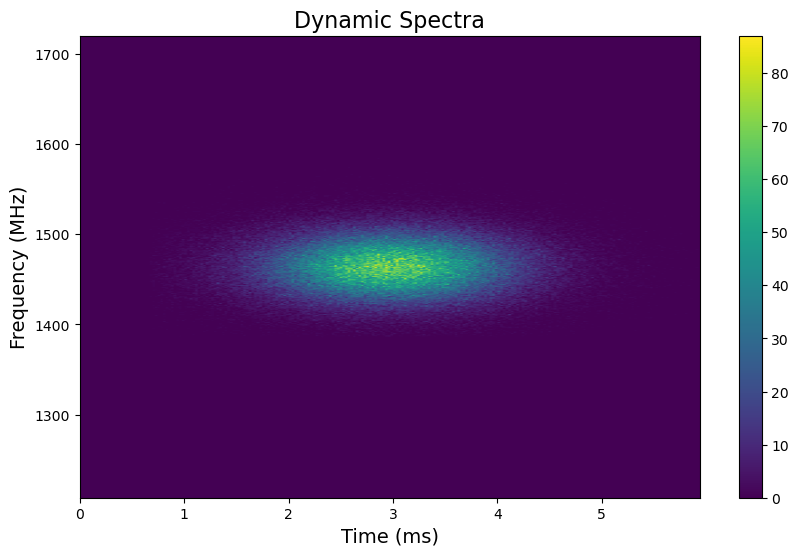

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0007513462724021583
Frequency: 25.21755836991096
Center Frequency: 1465.4386800520347
(280, 512)


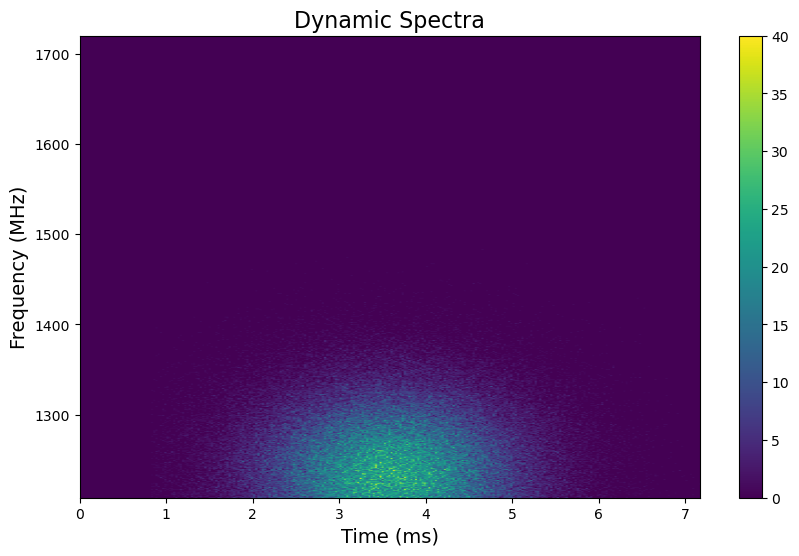

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0008884175882551091
Frequency: 58.20031200513986
Center Frequency: 1231.2288482125944
(296, 512)


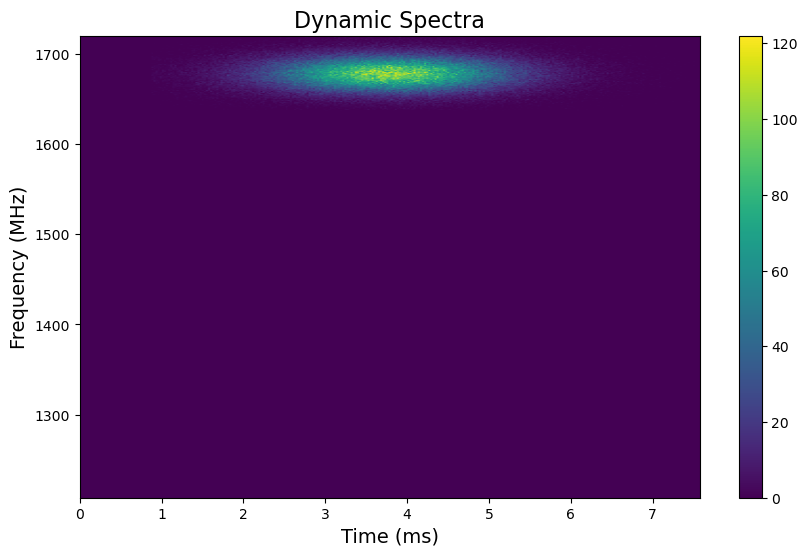

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0009353411795076765
Frequency: 13.285259665990564
Center Frequency: 1678.9713999247706
(440, 512)


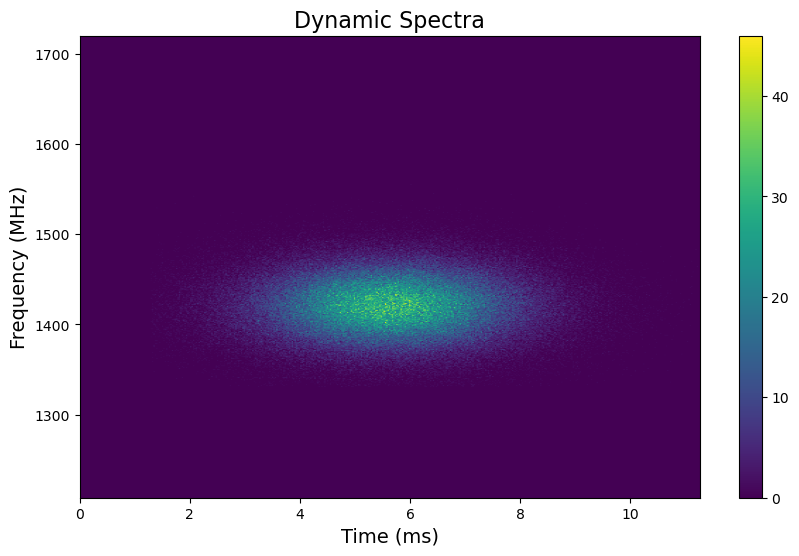

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0014164112553494057
Frequency: 28.703884110288154
Center Frequency: 1421.982292194644
(224, 512)


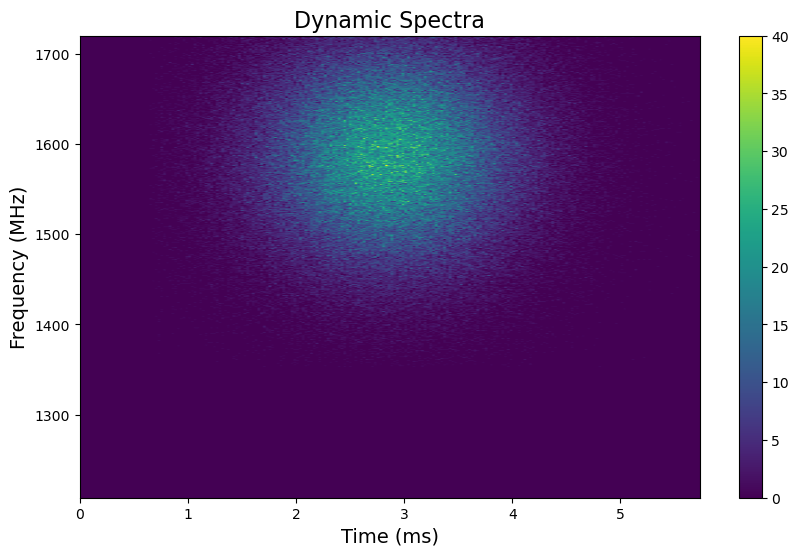

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0007114534864249029
Frequency: 75.6121712607316
Center Frequency: 1589.1290604708997
(408, 512)


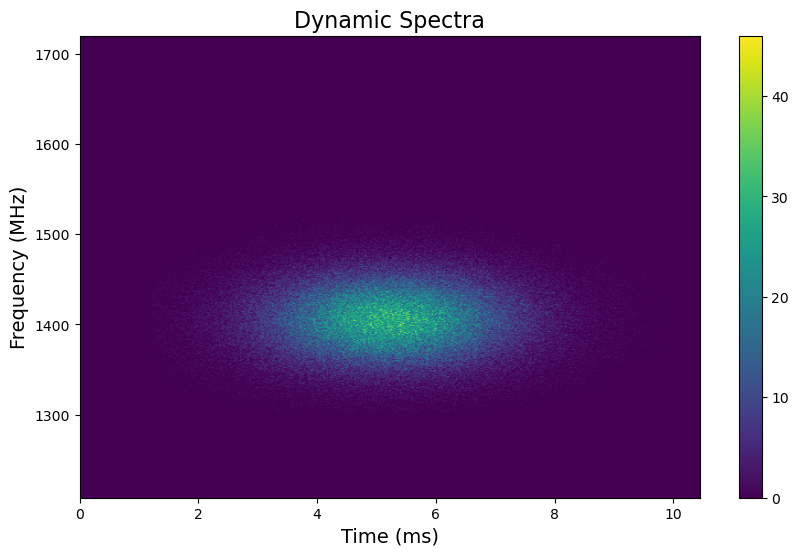

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.001303586532057261
Frequency: 33.108953593339926
Center Frequency: 1406.231961627829
(456, 512)


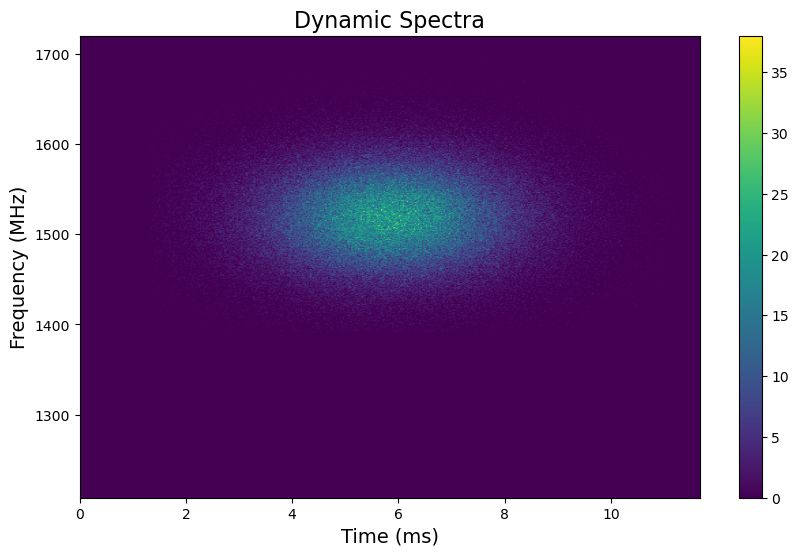

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0014680786167110078
Frequency: 40.9066993663493
Center Frequency: 1519.9838333145833
(56, 512)


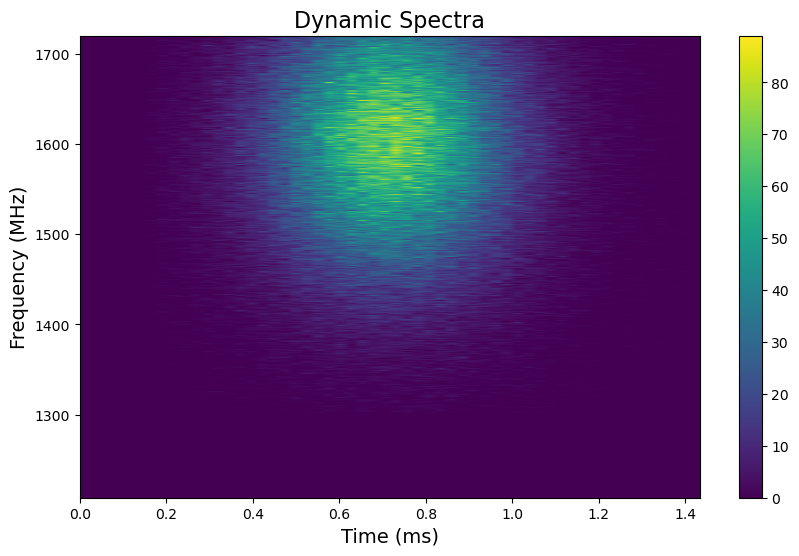

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.00016722850410305558
Frequency: 98.5370747514772
Center Frequency: 1608.8365746320096
(184, 512)


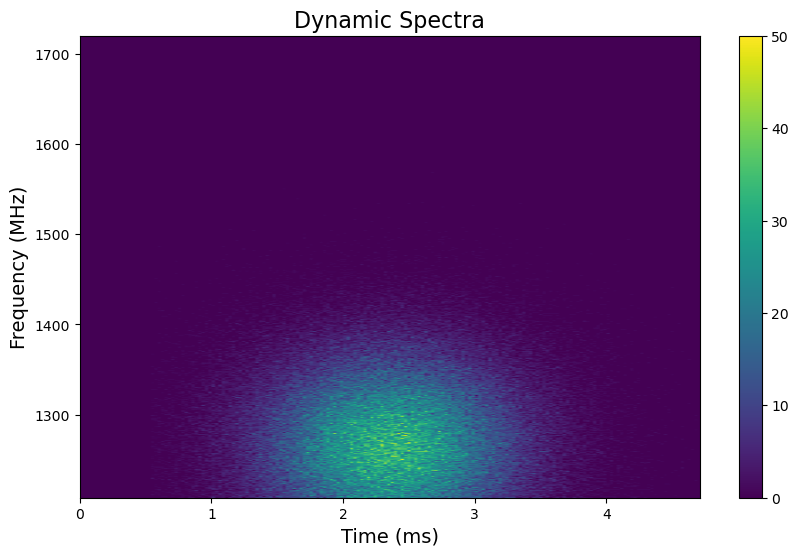

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0005767972533495317
Frequency: 65.34197442536257
Center Frequency: 1263.6995937891759
(104, 512)


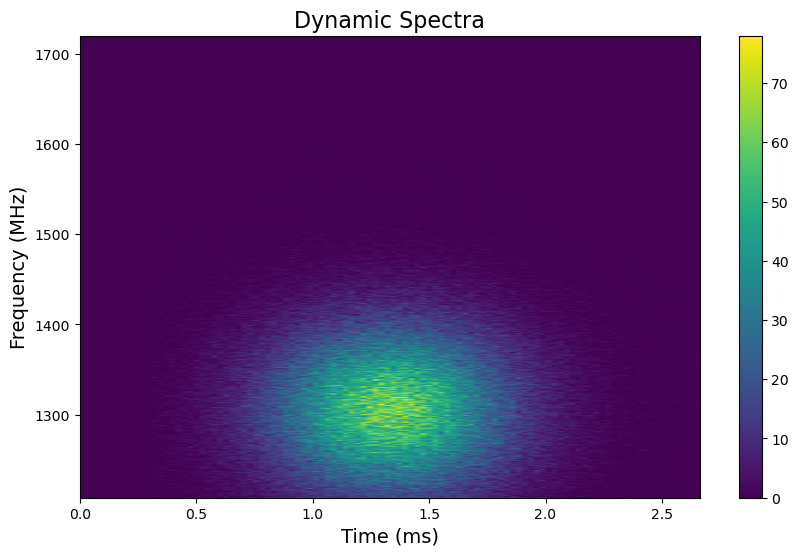

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0003302824115246903
Frequency: 61.05248217613393
Center Frequency: 1307.2521836704675
(304, 512)


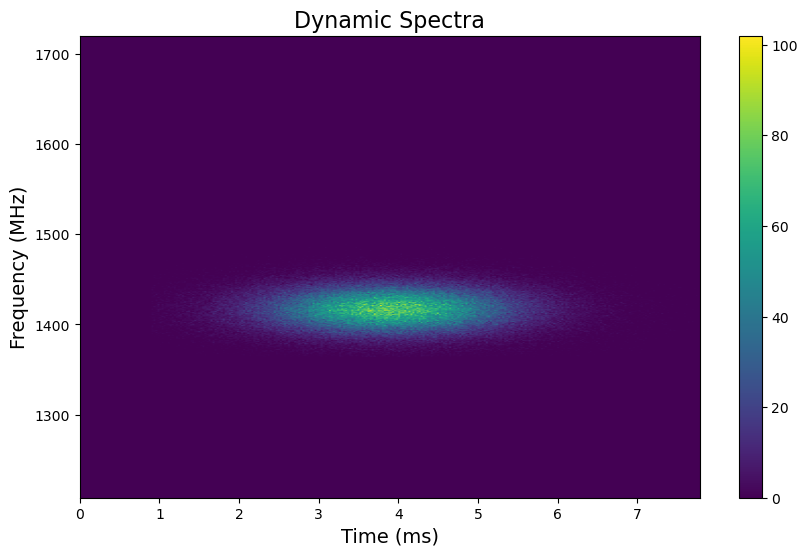

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0009760991354071226
Frequency: 16.82889513697214
Center Frequency: 1417.5189226840796
(168, 512)


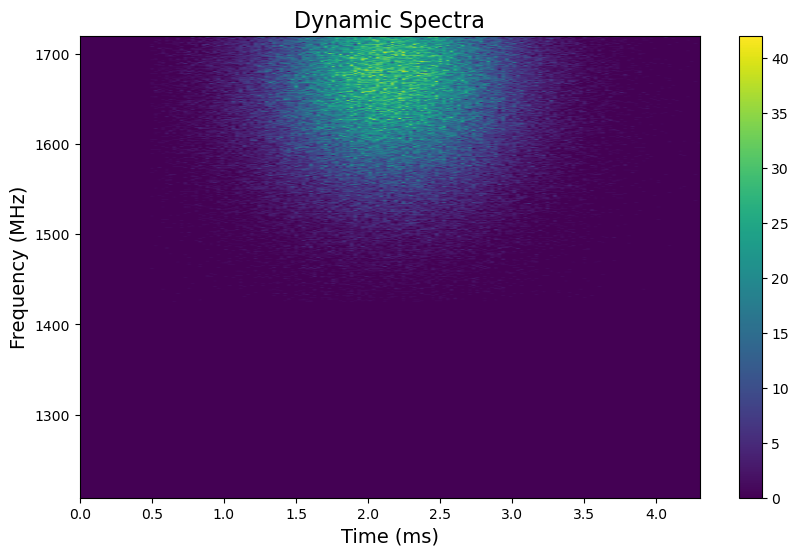

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.000537540140222566
Frequency: 83.360595400139
Center Frequency: 1682.75533538991
(248, 512)


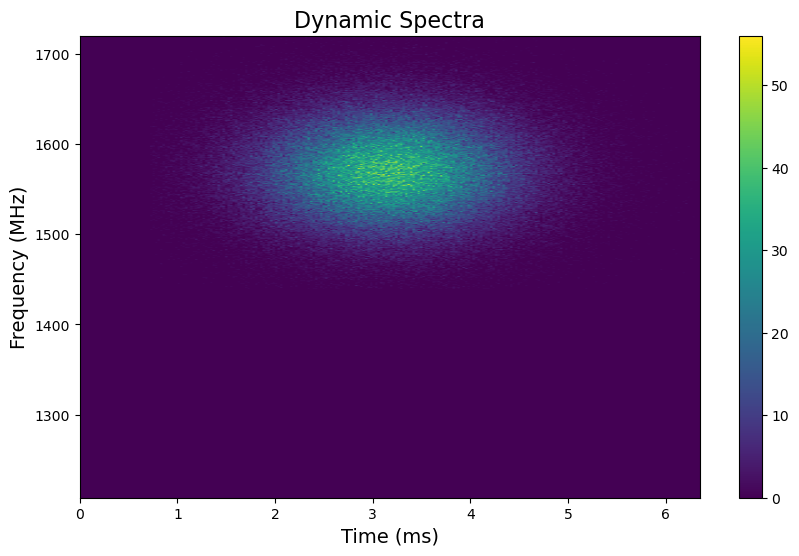

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0008048838511036539
Frequency: 42.200131168548225
Center Frequency: 1571.449802159972
(264, 512)


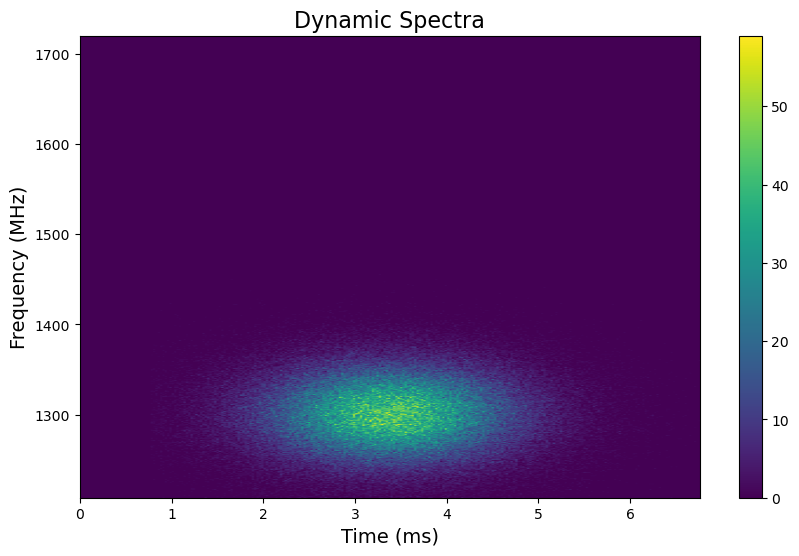

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0008463952898904778
Frequency: 34.05538187924897
Center Frequency: 1302.4032277445178
(224, 512)


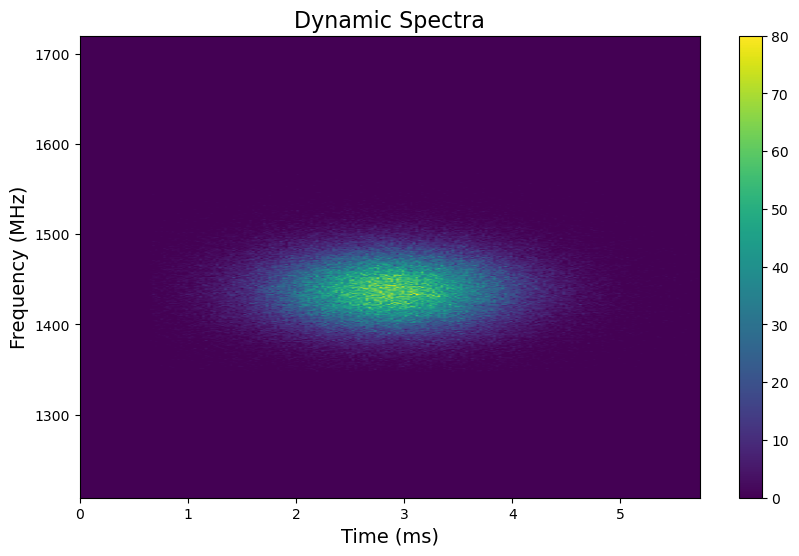

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.000714445379079135
Frequency: 29.21874107207856
Center Frequency: 1438.7790878827168
(440, 512)


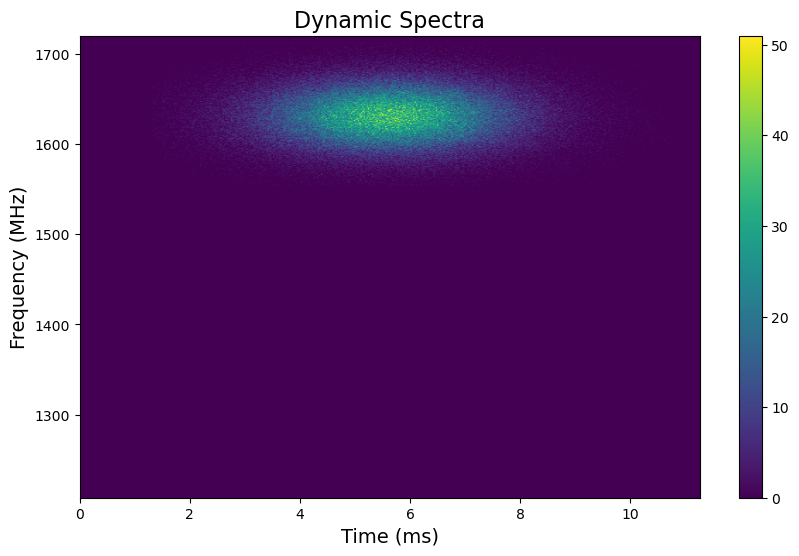

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0013998559673819395
Frequency: 24.820609652044602
Center Frequency: 1631.7854574180246
(304, 512)


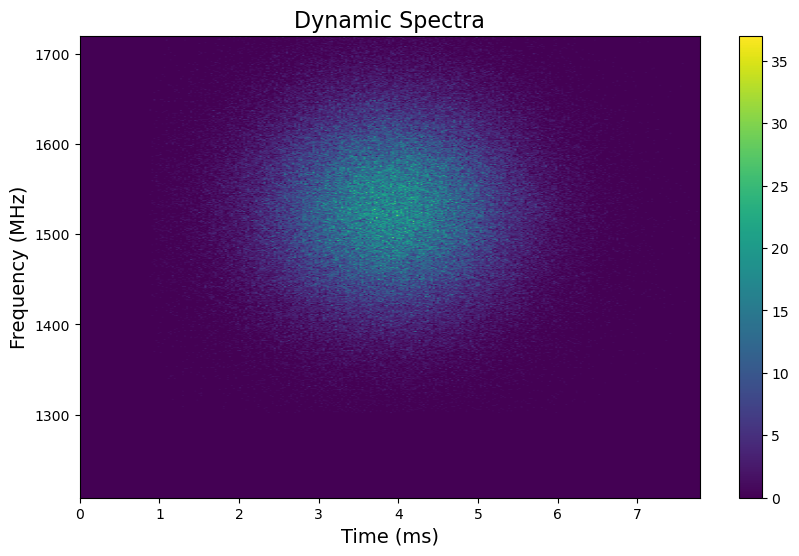

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0009660197572981736
Frequency: 73.1267387877633
Center Frequency: 1529.1753769623015
(224, 512)


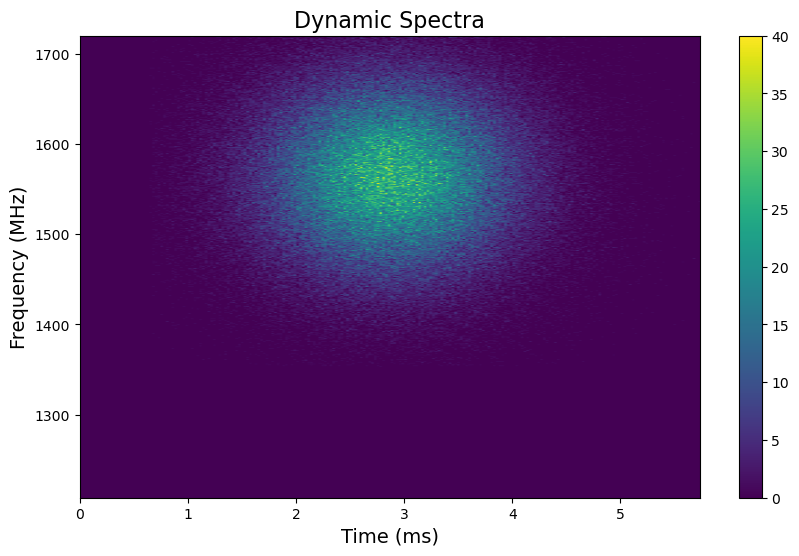

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0007289810045656544
Frequency: 67.83946038017439
Center Frequency: 1564.833238326121
(184, 512)


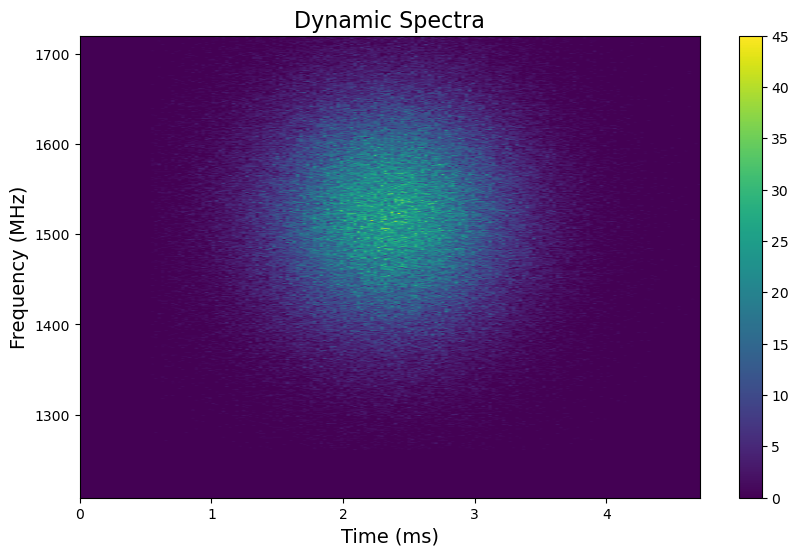

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0005840322183192634
Frequency: 84.08672366954107
Center Frequency: 1521.883286132724
(208, 512)


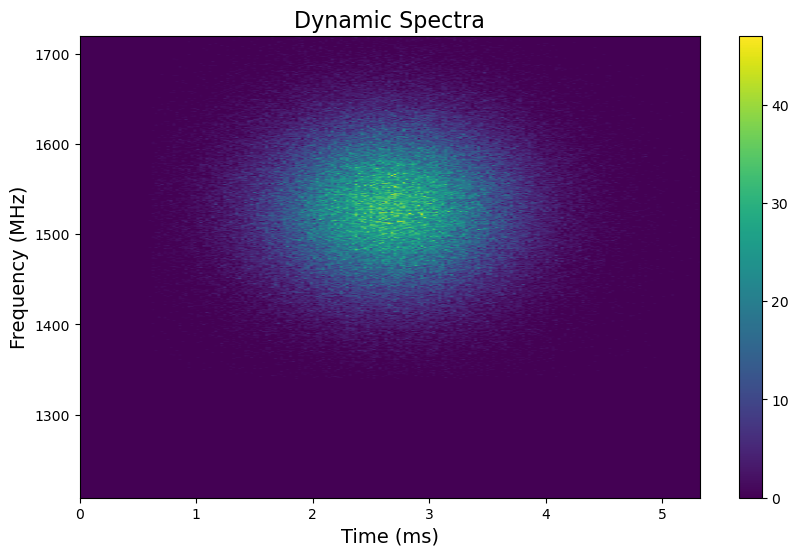

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0006775228805514768
Frequency: 61.43851097929836
Center Frequency: 1529.8155934244146
(168, 512)


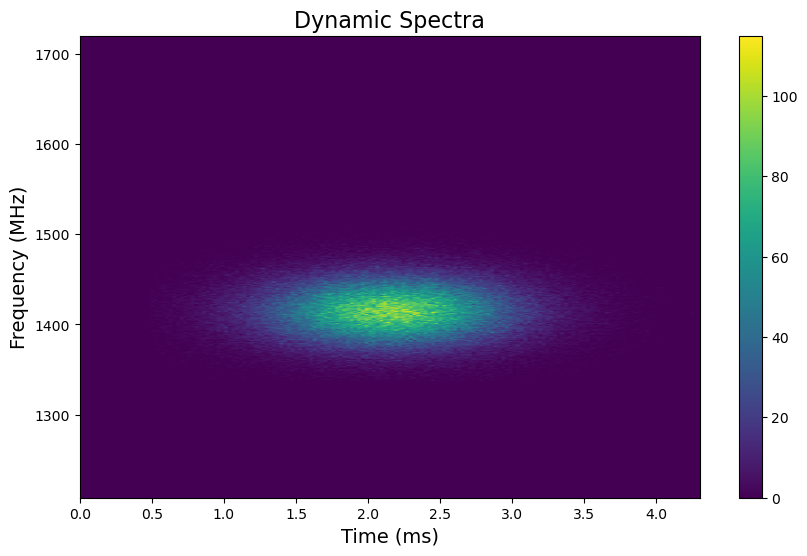

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0005320557660095627
Frequency: 25.39770764541766
Center Frequency: 1415.9232408711987
(240, 512)


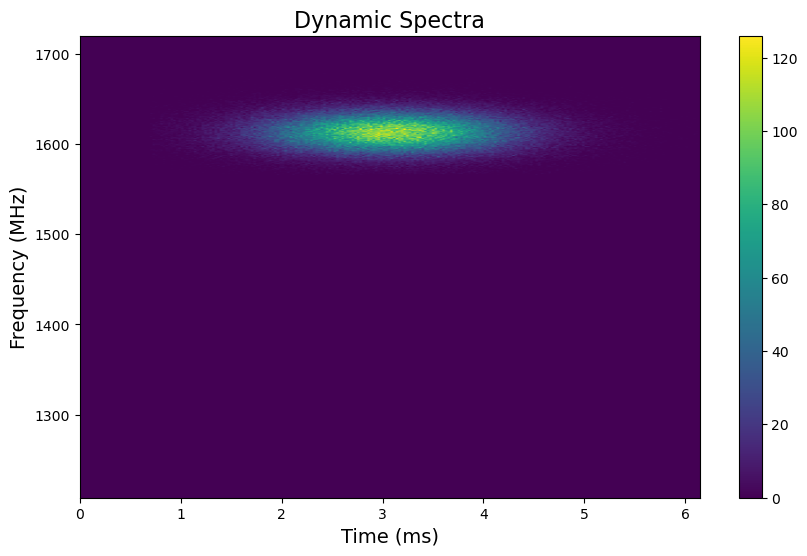

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.000763993750130601
Frequency: 14.622226872550767
Center Frequency: 1613.955949548888
(160, 512)


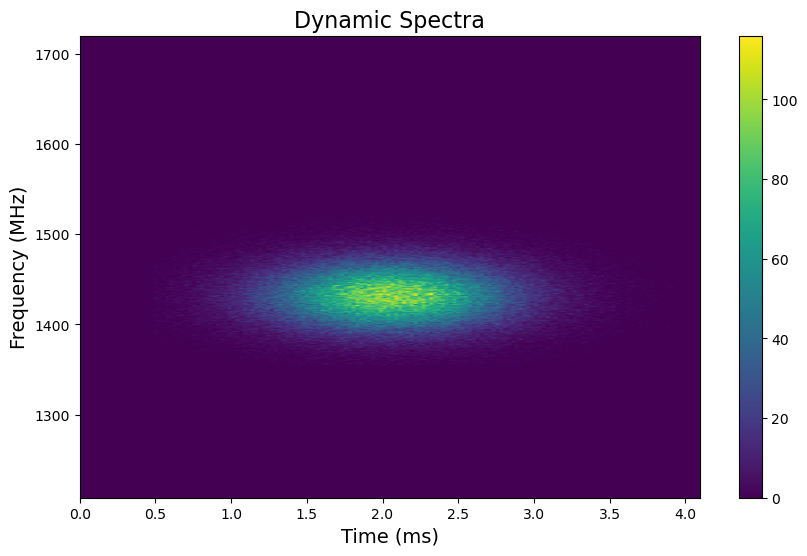

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0005186346420872852
Frequency: 25.379016866362015
Center Frequency: 1433.0080306891946
(128, 512)


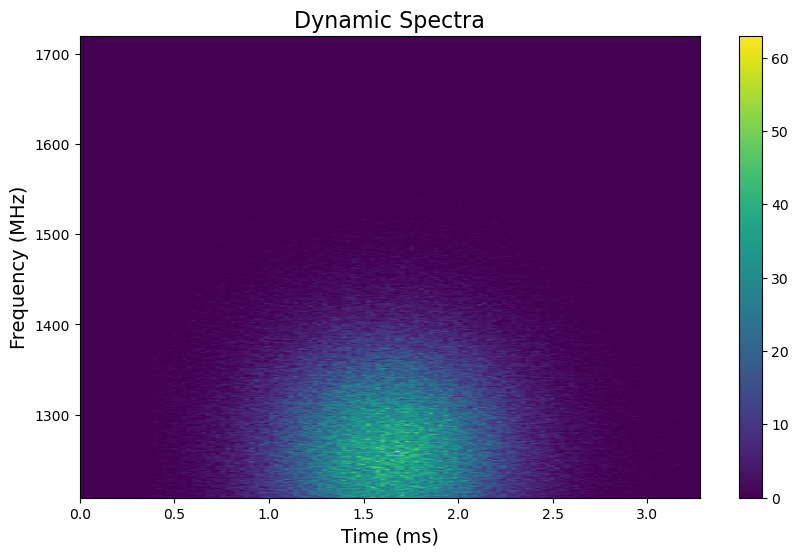

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.00039822487853517785
Frequency: 79.49163464589623
Center Frequency: 1256.8204244820556
(288, 512)


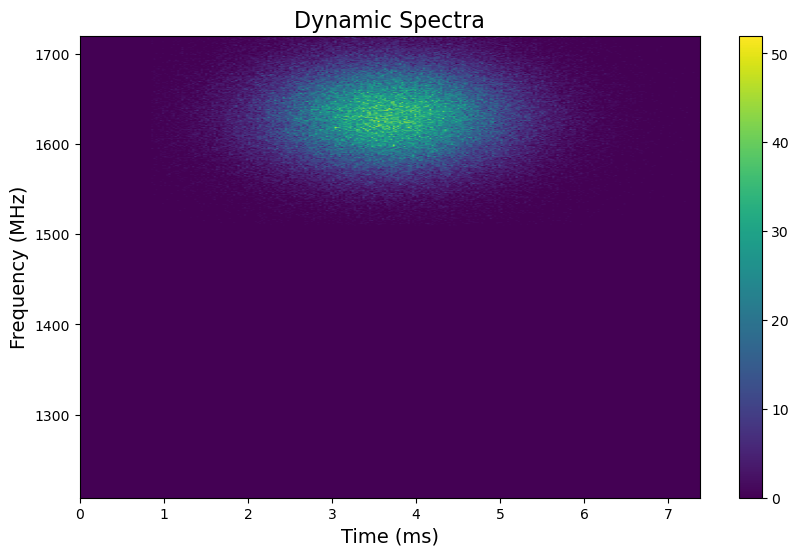

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0009223645131016569
Frequency: 38.55179702584033
Center Frequency: 1631.9103006951882
(248, 512)


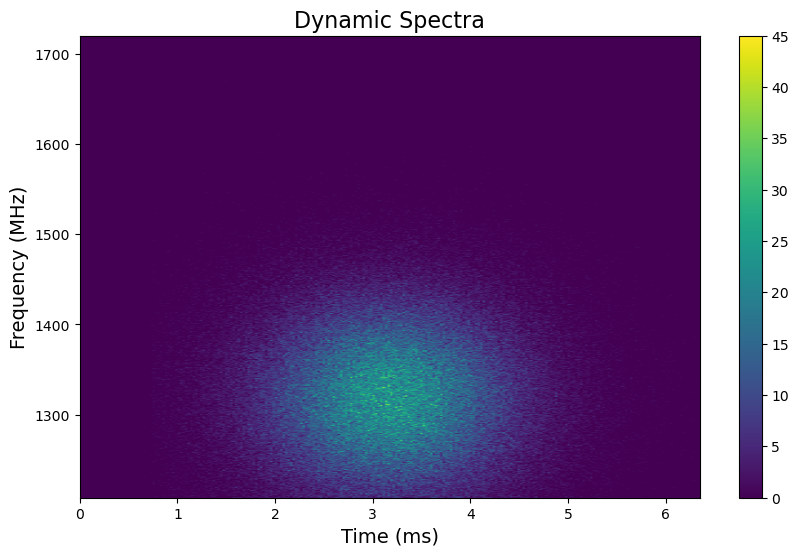

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0007957692384547914
Frequency: 65.81441624132475
Center Frequency: 1319.1659008057577
(168, 512)


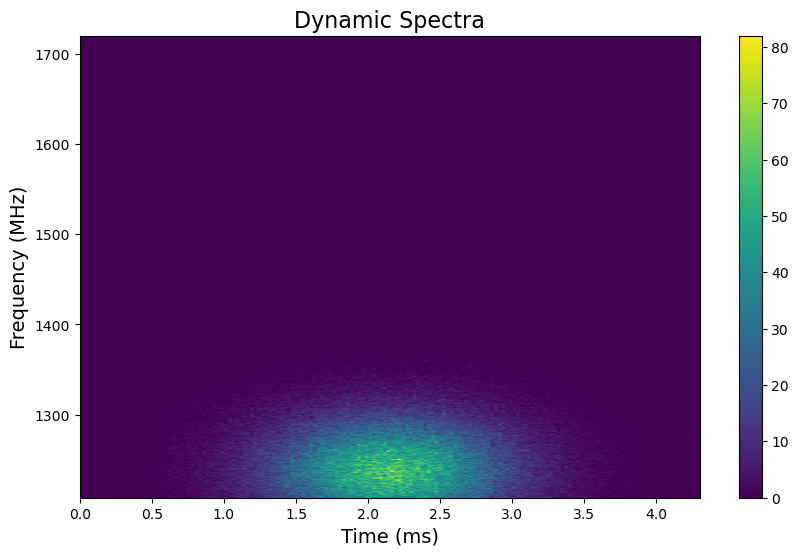

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0
Time: 0.0005262396743419499
Frequency: 40.283119148724694
Center Frequency: 1237.5973322189848


In [147]:
for i in range(100):

    sigma_time=generate_sigma_time(0.0008, 0.0004)
    sigma_freq=generate_sigma_freq(12.5, 100)
    center_freq=generate_center_freq(1228, 1700)

    dm = 0
    # create the pulse object
    pulse_obj = create.SimpleGaussPulse(
        sigma_time=sigma_time,
        sigma_freq=sigma_freq,
        center_freq=center_freq,
        dm=dm,
        tau=0,
        phi=np.pi / 3,
        spectral_index_alpha=0,
        chan_freqs=yr_obj.chan_freqs,
        tsamp=yr_obj.your_header.tsamp,
        nscint=0,
        bandpass=None,
    )


    # pulse with 3e5 samples
    pulse = pulse_obj.sample_pulse(nsamp=int(3e5), dtype=np.float32)
    pulse = pulse[:, 208:720]

    print(pulse.shape)

    plot_dynamic_spectra(pulse)

    print(pulse)
    pulse = pulse / np.max(pulse)

    print(f"Maximum value in the pulse: {np.max(pulse)}")

    print(f'Time: {sigma_time}')
    print(f'Frequency: {sigma_freq}')
    print(f'Center Frequency: {center_freq}')


## Scale the pulse for SNR

In [141]:
scaling_factor = get_scaling_factor(min_value=0.02, max_value=0.4, exponent = -1.5)

print(scaling_factor)

pulse = (pulse * scaling_factor).astype(np.float32)

0.19287179977642005


## Inject the Pulse

In [142]:
# Inject the pulse into the dynamic spectrum
dynamic_spectra_with_pulse = inject_pulse_into_dynamic_spectrum(dynamic_spectra, pulse)

## Show injected Pulse

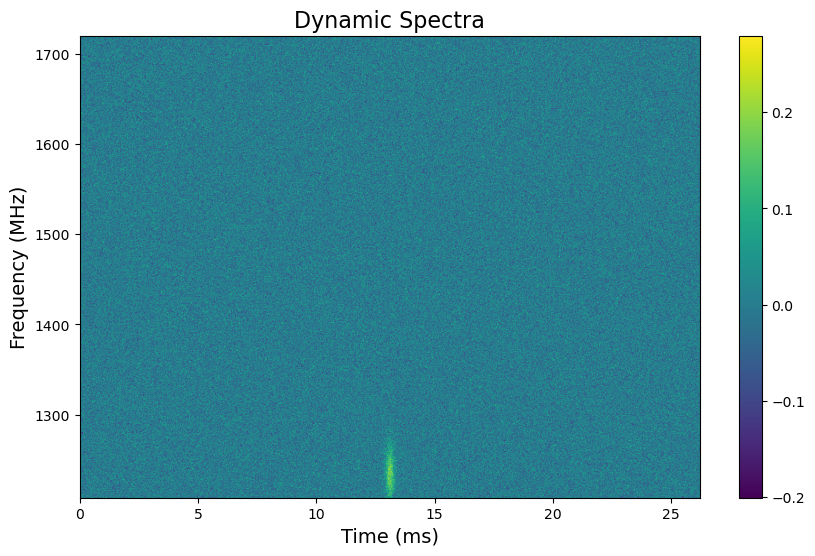

In [143]:
plot_dynamic_spectra(dynamic_spectra_with_pulse)

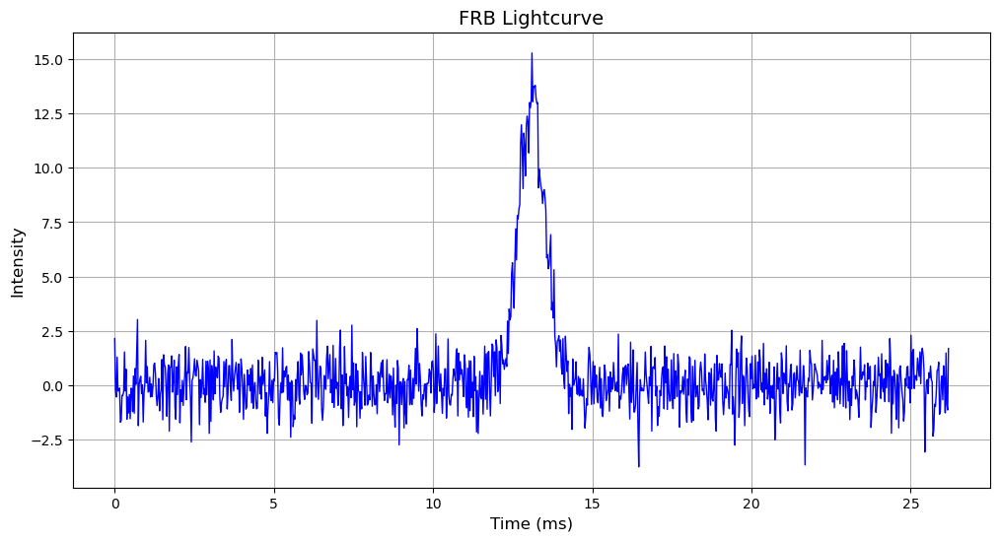

RMS of the noise: 1.024938941001892
15.291975
1.0249387
14.919892
14.9198885


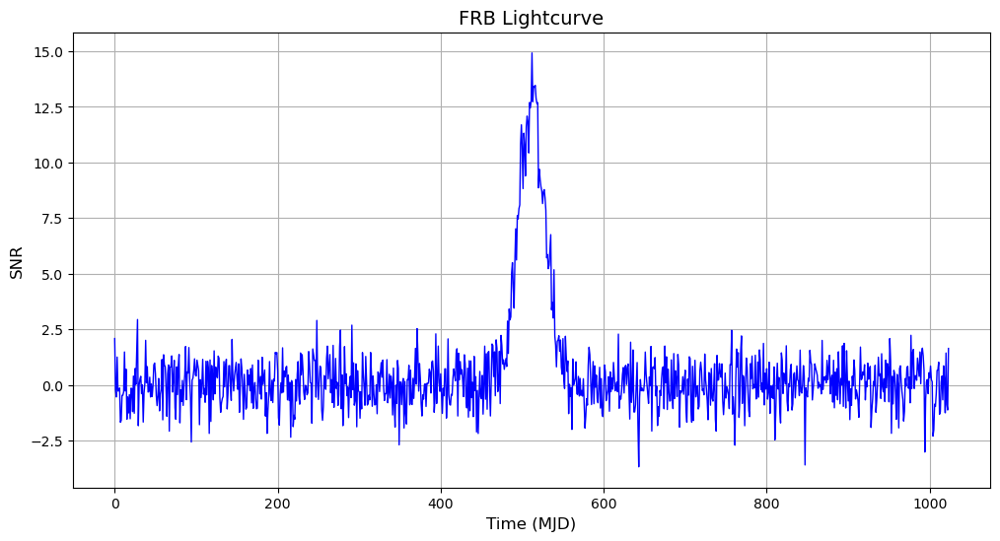

In [139]:
# Sum the frequencies along the frequency axis to get a 1D time series (lightcurve)
lightcurve = np.sum(dynamic_spectra_with_pulse,axis=1)

plot_lightcurve(time_samples=np.arange(1024), lightcurve=lightcurve)

squared_values = lightcurve[0:100] ** 2

# Calculate the mean of the squared values
mean_squared = np.mean(squared_values)

# Take the square root to get the RMS
rms = np.sqrt(mean_squared)

print(f"RMS of the noise: {rms}")

print(np.max(lightcurve))
print(np.std(lightcurve[0:100]))

print(np.max(lightcurve) / np.std(lightcurve[0:100]))

print(np.max(lightcurve)/rms)

# Plot the lightcurve
plt.figure(figsize=(12, 6))
plt.plot(np.arange(1024), lightcurve/np.std(lightcurve[0:100]), color='blue', lw=1)
plt.xlabel("Time (MJD)", fontsize=12)
plt.ylabel("SNR", fontsize=12)
plt.title("FRB Lightcurve", fontsize=14)
plt.grid(True)
plt.show()


## Now for a pulse with a scattering tail

In [8]:
# Create a filterbank with noise, std is such that the lightcurve will have std 1
create_filterbank_with_noise("output_with_noise__2.fil", std_value=np.sqrt(1.0/512), mean_value=0.0, num_frequency_channels=512, num_time_samples=1024)

# Get the dynamic spectra from a filterbank file with 1024 time samples
dynamic_spectra, yr_obj = get_dynamic_spectra_from_filterbank(file_name='output_with_noise__2.fil', num_time_samples=1024)

(1120, 512)


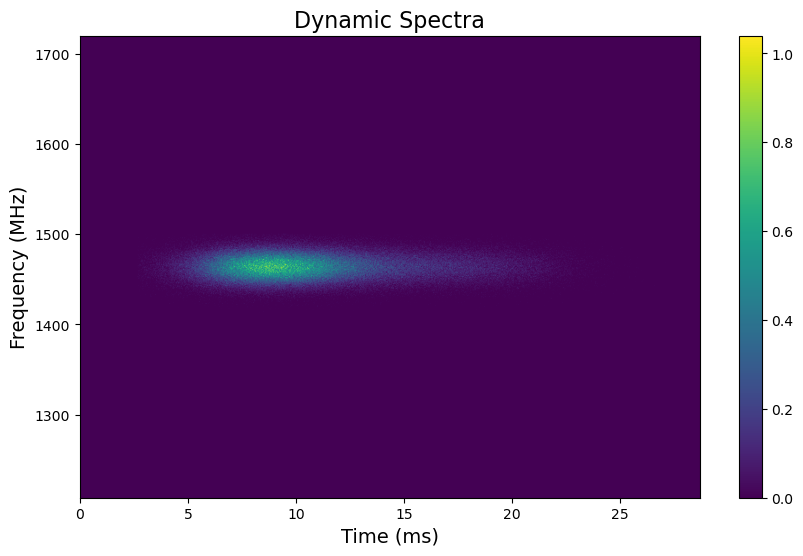

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
Maximum value in the pulse: 1.0399999618530273


In [9]:
dm = 0
# create the pulse object
pulse_obj = create.SimpleGaussPulse(
    sigma_time=0.015/8,
    sigma_freq=100/8,
    center_freq=yr_obj.your_header.center_freq,
    dm=dm,
    tau=67,
    phi=np.pi / 3,
    spectral_index_alpha=0,
    chan_freqs=yr_obj.chan_freqs,
    tsamp=yr_obj.your_header.tsamp,
    nscint=0,
    bandpass=None,
)


# pulse with 3e5 samples
pulse = pulse_obj.sample_pulse(nsamp=int(3e5), dtype=np.float32)

print(np.shape(pulse))

pulse = (pulse * 0.02).astype(np.float32)

plot_dynamic_spectra(pulse)

print(pulse)
max_value = np.max(pulse)

print(f"Maximum value in the pulse: {max_value}")

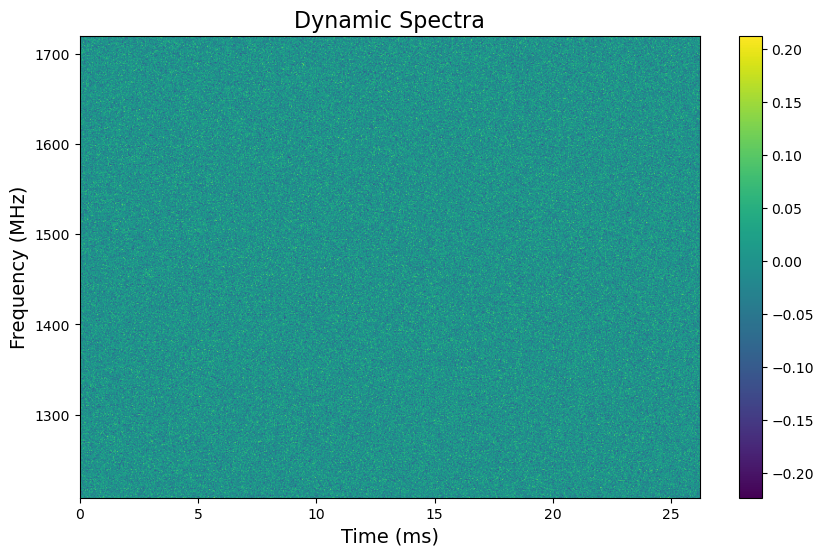

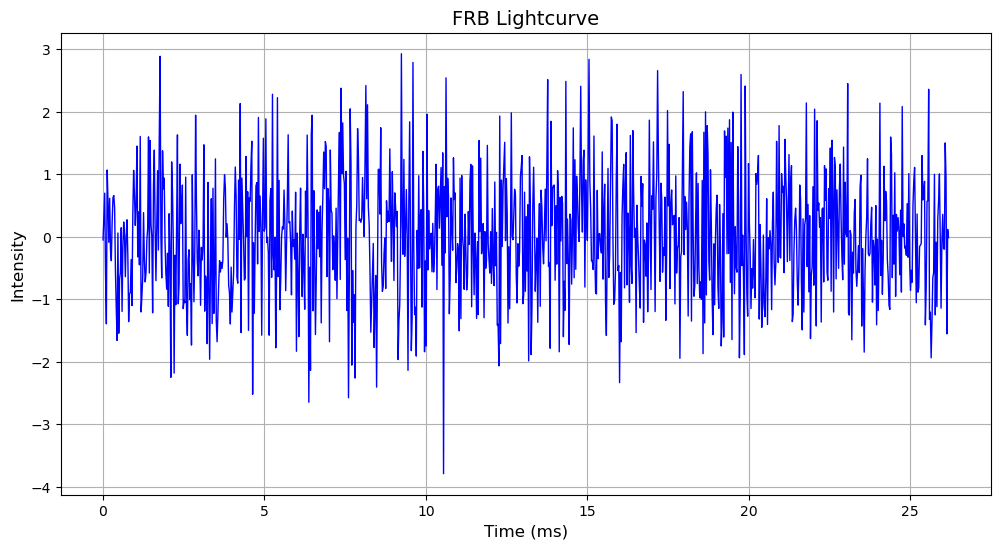

In [10]:
# Inject the pulse into the dynamic spectrum
dynamic_spectra_with_scattered_pulse = inject_pulse_into_dynamic_spectrum(dynamic_spectra, pulse)

plot_dynamic_spectra(dynamic_spectra_with_scattered_pulse)

lightcurve = np.sum(dynamic_spectra_with_scattered_pulse, axis=1)

plot_lightcurve(time_samples=np.arange(1024), lightcurve=lightcurve)

## Now for a pulse with complex time-frequency structure

In [12]:
# Create a filterbank with noise, std is such that the lightcurve will have std 1
create_filterbank_with_noise("output_with_noise__2.fil", std_value=np.sqrt(1.0/512), mean_value=0.0, num_frequency_channels=512, num_time_samples=1024)

# Get the dynamic spectra from a filterbank file with 1024 time samples
dynamic_spectra, yr_obj = get_dynamic_spectra_from_filterbank(file_name='output_with_noise__2.fil', num_time_samples=1024)

In [34]:
dm_1 = 0
pulse_obj_complex = create.GaussPulse(
    relative_intensities=(1, 1, 1),
    sigma_times=(0.000256, 0.001, 0.001),
    sigma_freqs=(100, 100, 20),
    pulse_thetas=(0, 0, 180/np.pi),
    center_freqs=(yr_obj.your_header.center_freq, yr_obj.your_header.center_freq, yr_obj.your_header.center_freq -200),
    dm=dm_1,
    tau=0,
    offsets=(0, 0.001, 0.003),  # all from start of window
    chan_freqs=yr_obj.chan_freqs,
    tsamp=yr_obj.your_header.tsamp,
    spectral_index_alpha=0,
    nscint=0,
    phi=np.pi / 3,
    bandpass=None,
)
# pulse with 3e5 samples
pulse_complex = pulse_obj_complex.sample_pulse(nsamp=int(3e5), dtype=np.float32)

max_value = np.max(pulse_complex)

print(f"Maximum value in the pulse: {max_value}")



Maximum value in the pulse: 26.0


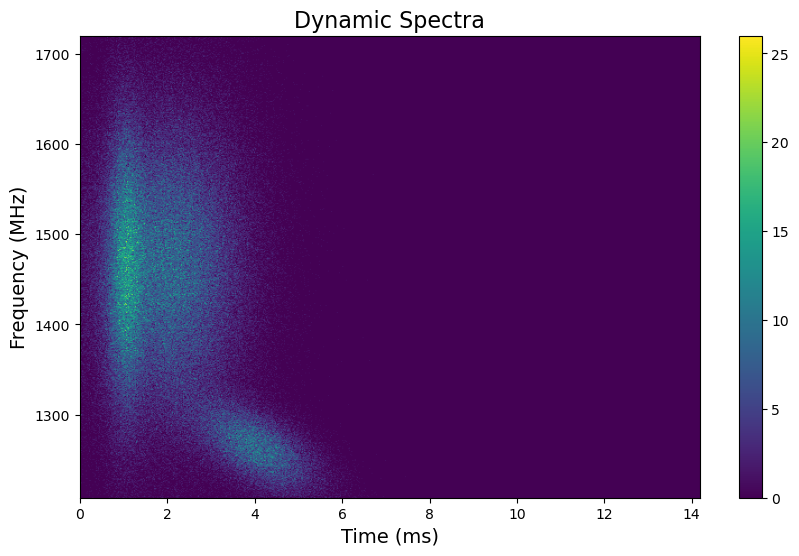

In [35]:
plot_dynamic_spectra(pulse_complex)

## Inject the pulse

Maximum value in the spectra: 23.046634674072266


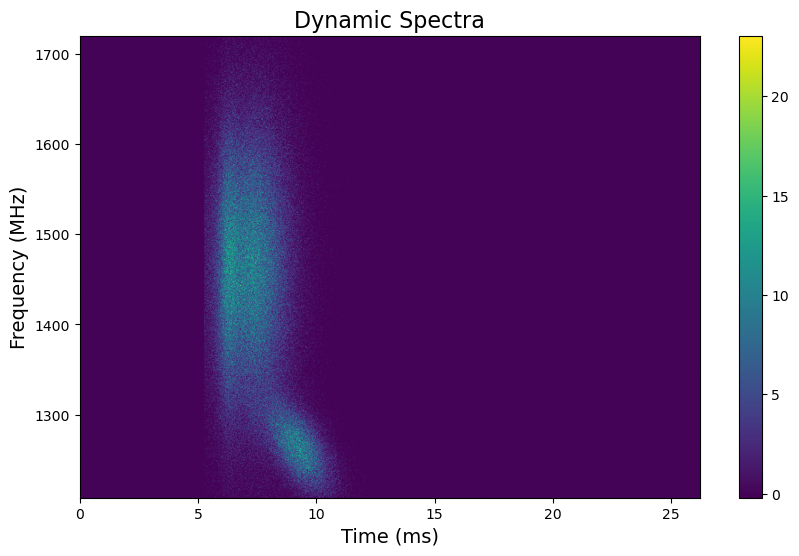

In [32]:
dynamic_spectra_with_complex_pulse = inject_pulse_into_dynamic_spectrum(dynamic_spectra, pulse_complex, pulse_start_time = dynamic_spectra.shape[0] // 5)

max_value = np.max(dynamic_spectra_with_complex_pulse)

print(f"Maximum value in the spectra: {max_value}")

plot_dynamic_spectra(dynamic_spectra_with_complex_pulse)


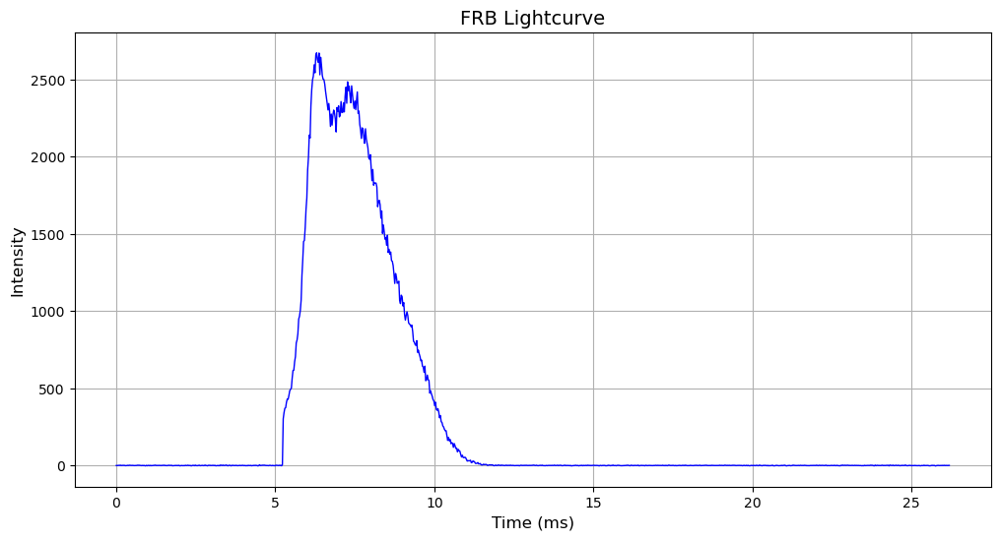

In [33]:
lightcurve_complex = np.sum(dynamic_spectra_with_complex_pulse, axis = 1)

plot_lightcurve(time_samples=(np.arange(1024)), lightcurve=lightcurve_complex)

## Generate complex frbs

In [111]:
import os
import numpy as np

# Directory to save the numpy arrays for complex pulses
save_dir_complex = "simulated_complex_frbs"

# Create the directory if it doesn't exist
os.makedirs(save_dir_complex, exist_ok=True)

# Set the constant DM value
dm = 200

# Define the mean values for the Gaussian distributions
mean_value_for_sigma_time = 0.005  # Mean value for pulse width
mean_value_for_sigma_freq = 350    # Mean value for frequency width

# Standard deviations for the Gaussian distributions (adjust as needed)
std_deviation_for_sigma_time = 0.001
std_deviation_for_sigma_freq = 50

# Generate 10 different dynamic spectra with varying signal and temporal widths for complex pulses
num_pulses = 100

for i in range(num_pulses):
    # Draw random values for signal width and temporal width from Gaussian distributions
    sigma_time = np.random.normal(mean_value_for_sigma_time, std_deviation_for_sigma_time)
    sigma_freq = np.random.normal(mean_value_for_sigma_freq, std_deviation_for_sigma_freq)
    
    # Create the pulse object with the specified parameters for complex pulses
    pulse_obj_complex = create.GaussPulse(
        relative_intensities=(1, 0.8, 0.8, 0.8),
        sigma_times=(sigma_time, sigma_time * 0.2, sigma_time * 0.2, sigma_time * 1.2),
        sigma_freqs=(sigma_freq, sigma_freq * 0.8, sigma_freq * 0.8, sigma_freq * 0.6),
        pulse_thetas=(0, 0, 0, -np.pi / 60),
        center_freqs=(yr_obj.your_header.center_freq, yr_obj.your_header.center_freq - 100, yr_obj.your_header.center_freq - 200, yr_obj.your_header.center_freq - 400),
        dm=dm,
        tau=25,
        offsets=(0, 0.01536, 0.02304, 0.03968),  # all from start of window
        chan_freqs=yr_obj.chan_freqs,
        tsamp=yr_obj.your_header.tsamp,
        spectral_index_alpha=0,
        nscint=2,
        phi=0,
        bandpass=None,
    )

    # Scale the SNR of the pulse according to powerlaw with slope -1.5 so more weak pulses
    min_value = .75
    max_value = 5

    # Define the exponent for the power law distribution
    exponent = -1.5  # Use a negative exponent

    # Generate a random number from a power law-like distribution
    scaling_factor = ((max_value**(exponent+1) - min_value**(exponent+1)) * np.random.random(1) + min_value**(exponent+1))**(1/(exponent+1))

    # Generate the complex pulse signal with the specified parameters
    pulse_complex = pulse_obj_complex.sample_pulse(nsamp=int(3e5))

    pulse_complex = pulse_complex * int(scaling_factor)
    
    
    
    # Inject the complex pulse into the dynamic spectra
    dynamic_spectra_w_pulse_complex = inject.inject_constant_into_file(
        yr_input=yr_obj,
        pulse=pulse_complex,
        start=yr_obj.your_header.nspectra // 2,
        gulp=yr_obj.your_header.nspectra,
    )

    dynamic_spectra_w_pulse_complex_dedisp = dedisperse(
        dynamic_spectra_w_pulse_complex,
        dm=dm,
        chan_freqs=yr_obj.chan_freqs,
        tsamp=yr_obj.your_header.tsamp,
    )
    
    # Define a filename for the numpy array for complex pulses
    filename_complex = os.path.join(save_dir_complex, f"complex_frb_{i}_{sigma_time}_{sigma_freq}.npy")
    
    # Save the dynamic spectra with complex pulses as a numpy array
    np.save(filename_complex, dynamic_spectra_w_pulse_complex_dedisp)


RuntimeError: gulp=1024 is not larger that nsamples=1923